<a href="https://colab.research.google.com/github/jwdagney55/DSPS_JDagney/blob/main/HW9/HW9_Dagney.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DeepDreaming with TensorFlow

#modified by FBB (@fedhere) for UD DSPS 2019 class last updated for DSPS 2021 including upgrading to python3 and current version of TF

### ___Alex Mordvintsev___

This notebook produces DeepDream images from user-supplied photos using Google's pretrained Inception neural network. It can be used as a starting point for further exploration in visualizing convolutional neural networks.

###  Load the model graph

The pretrained Inception network can be downloaded [here](https://storage.googleapis.com/download.tensorflow.org/models/inception5h.zip). This next cell downloads the file automatically and unpacks it locally to the Colab kernel. We can the load the contained model file  'tensorflow_inception_graph.pb' in the cell below.

In [1]:
!wget -nc --no-check-certificate https://storage.googleapis.com/download.tensorflow.org/models/inception5h.zip && unzip -n inception5h.zip

from io import BytesIO
from IPython.display import clear_output, Image, display
import numpy as np
import PIL.Image
import tensorflow as tf
import pylab as pl
from __future__ import print_function

model_fn = 'tensorflow_inception_graph.pb'

# creating TensorFlow session and loading the model
graph = tf.Graph()
sess = tf.compat.v1.InteractiveSession(graph=graph)
with tf.compat.v2.io.gfile.GFile(model_fn, 'rb') as f:

    graph_def = tf.compat.v1.GraphDef()   # -> instead of tf.GraphDef() 
    graph_def.ParseFromString(f.read())
t_input = tf.compat.v1.placeholder(np.float32, name='input') # define the input tensor
imagenet_mean = 117.0
t_preprocessed = tf.expand_dims(t_input-imagenet_mean, 0)
tf.import_graph_def(graph_def, {'input':t_preprocessed})

def T(layer):
    '''Helper for getting layer output tensor'''
    return graph.get_tensor_by_name("import/%s:0"%layer)

--2021-11-28 17:50:55--  https://storage.googleapis.com/download.tensorflow.org/models/inception5h.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 209.85.146.128, 209.85.147.128, 142.250.125.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|209.85.146.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 49937555 (48M) [application/zip]
Saving to: ‘inception5h.zip’

inception5h.zip     100%[===================>]  47.62M  79.2MB/s    in 0.6s    

2021-11-28 17:50:56 (79.2 MB/s) - ‘inception5h.zip’ saved [49937555/49937555]

Archive:  inception5h.zip
  inflating: imagenet_comp_graph_label_strings.txt  
  inflating: tensorflow_inception_graph.pb  
  inflating: LICENSE                 


make sure you are running on the GPUs - on the notebook menu go to 

Runtime\-\>Change Runtime type




In [2]:
!wget https://github.com/fedhere/DSPS_FBianco/raw/master/HW9/runtime.png

--2021-11-28 17:51:01--  https://github.com/fedhere/DSPS_FBianco/raw/master/HW9/runtime.png
Resolving github.com (github.com)... 140.82.113.3
Connecting to github.com (github.com)|140.82.113.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/fedhere/DSPS_FBianco/master/HW9/runtime.png [following]
--2021-11-28 17:51:01--  https://raw.githubusercontent.com/fedhere/DSPS_FBianco/master/HW9/runtime.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 50464 (49K) [image/png]
Saving to: ‘runtime.png’

runtime.png         100%[===================>]  49.28K  --.-KB/s    in 0.01s   

2021-11-28 17:51:01 (4.99 MB/s) - ‘runtime.png’ saved [50464/50464]



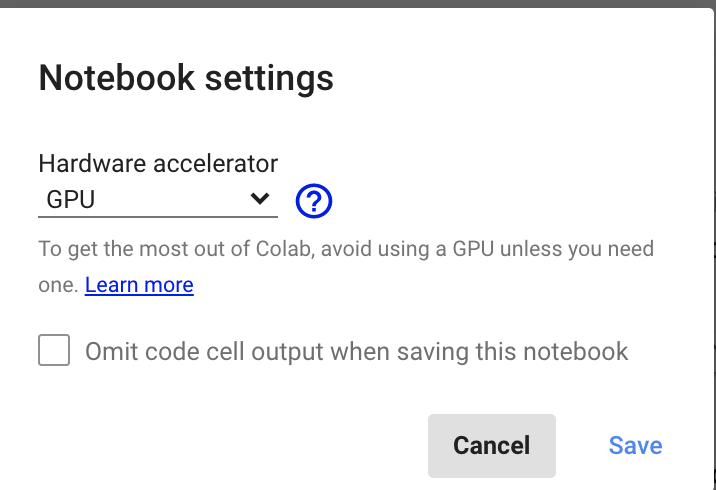

In [3]:
from IPython.display import Image
Image(filename='runtime.png') 

In [4]:
def showarray(a, fmt='jpeg'):
    #if a is > 3 axis cut the last one assuming its alpha-transparency 
    if a.shape[-1] == 4:
      a = a[:,:,:3]
    a = np.uint8(np.clip(a, 0, 255))
    f = BytesIO()
    PIL.Image.fromarray(a).save(f, fmt)
    display(Image(data=f.getvalue()))
    


# Task 1: Create a random noise "image": 
an array of 300x300 pixels and 3 color channels (RGB). Fill it in with random noise but make sure the values are Unsigned integer 8bit type (np.unit8) and contained between 0 and 255. This is how a jpg image would be encoded in python and both pylab and this base code require this encoding for the image.  This can be achieved by generating random uniform noise (between 0 and 1) and convert it to 0-255 by multiplication, then convert the data type

In [5]:
#set the seed
np.random.seed(555)

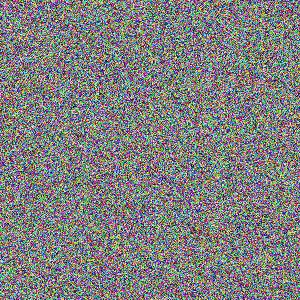

In [6]:
rnd = (np.random.rand(300*300*3).reshape(300,300,3)*255).astype(np.uint8)
showarray(rnd)


#Figure 1.
Random Noise Image

In [7]:
# These parameters let us control the strenth of the deepdream.
octave_n = 4
octave_scale = 1.4
iter_n = 10
strength = 200

# Helper function that uses TensorFlow to resize an image
def resize(img, new_size):
    return sess.run(tf.compat.v1.image.resize_bilinear(img[np.newaxis,:], new_size))[0]

# Apply gradients to an image in a series of tiles
def calc_grad_tiled(img, t_grad, tile_size=256):
    '''Random shifts are applied to the image to blur tile boundaries over
    multiple iterations.'''
    h, w = img.shape[:2]
    sx, sy = np.random.randint(tile_size, size=2)
    # We randomly roll the image in x and y to avoid seams between tiles.
    img_shift = np.roll(np.roll(img, sx, 1), sy, 0)
    grad = np.zeros_like(img)
    for y in range(0, max(h-tile_size//2, tile_size),tile_size):
        for x in range(0, max(w-tile_size//2, tile_size),tile_size):
            sub = img_shift[y:y+tile_size,x:x+tile_size]
            g = sess.run(t_grad, {t_input:sub})
            grad[y:y+tile_size,x:x+tile_size] = g
    imggrad = np.roll(np.roll(grad, -sx, 1), -sy, 0)
    # Add the image gradient to the image and return the result
    return img + imggrad*(strength * 0.01 / (np.abs(imggrad).mean()+1e-7))

# Applies deepdream at multiple scales
def render_deepdream(t_obj, input_img, show_steps = True):
    # Collapse the optimization objective to a single number (the loss)
    t_score = tf.reduce_mean(t_obj)
    # We need the gradient of the image with respect to the objective
    t_grad = tf.gradients(t_score, t_input)[0]

    # split the image into a number of octaves (laplacian pyramid)
    img = input_img
    octaves = []
    for i in range(octave_n-1):
        lo = resize(img, np.int32(np.float32(img.shape[:2])/octave_scale))
        octaves.append(img-resize(lo, img.shape[:2]))
        img = lo

    # generate details octave by octave
    for octave in range(octave_n):
        if octave>0:
            hi = octaves[-octave]
            img = resize(img, hi.shape[:2])+hi
        for i in range(iter_n):
            img = calc_grad_tiled(img, t_grad)
        if show_steps:
            clear_output()
            showarray(img)
    return img

# Task 2 start a deep dream : 

Adjust the sliders to change the strength of the deep dream, and how many scales it is applied over and until you obtain a "phsychadelic" result that you like

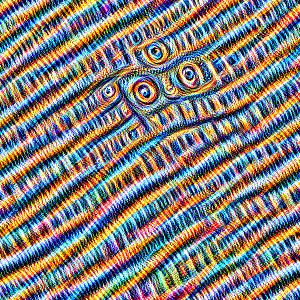

In [8]:
octave_n = 5 #@param {type:"slider", max: 10}
octave_scale = 1.4 #@param {type:"number"}
iter_n = 29 #@param {type:"slider", max: 50}
strength = 645 #@param {type:"slider", max: 1000}
layer = "mixed3b"  #@param ["mixed3a", "mixed3b", "mixed4a", "mixed4c", "mixed5a"]

final = render_deepdream(tf.square(T(layer)), rnd)


#Figure 2.
First look at deep dream processed image from the Random Noise image.

 # Task 3 pull each layer: 
 look at the bottom diagram that shows the architecture of the layer. Plot each relevant layer: the layers that start with "mixed"  

In [9]:
layers = [op.name for op in graph.get_operations() if op.type=='Conv2D' and 'import/' in op.name]
feature_nums = [int(graph.get_tensor_by_name(name+':0').get_shape()[-1]) for name in layers]

print('Number of layers', len(layers))
print('Total number of feature channels:', sum(feature_nums))

for layer in layers:
  print('Layer:', layer)

Number of layers 59
Total number of feature channels: 7548
Layer: import/conv2d0_pre_relu/conv
Layer: import/conv2d1_pre_relu/conv
Layer: import/conv2d2_pre_relu/conv
Layer: import/mixed3a_1x1_pre_relu/conv
Layer: import/mixed3a_3x3_bottleneck_pre_relu/conv
Layer: import/mixed3a_3x3_pre_relu/conv
Layer: import/mixed3a_5x5_bottleneck_pre_relu/conv
Layer: import/mixed3a_5x5_pre_relu/conv
Layer: import/mixed3a_pool_reduce_pre_relu/conv
Layer: import/mixed3b_1x1_pre_relu/conv
Layer: import/mixed3b_3x3_bottleneck_pre_relu/conv
Layer: import/mixed3b_3x3_pre_relu/conv
Layer: import/mixed3b_5x5_bottleneck_pre_relu/conv
Layer: import/mixed3b_5x5_pre_relu/conv
Layer: import/mixed3b_pool_reduce_pre_relu/conv
Layer: import/mixed4a_1x1_pre_relu/conv
Layer: import/mixed4a_3x3_bottleneck_pre_relu/conv
Layer: import/mixed4a_3x3_pre_relu/conv
Layer: import/mixed4a_5x5_bottleneck_pre_relu/conv
Layer: import/mixed4a_5x5_pre_relu/conv
Layer: import/mixed4a_pool_reduce_pre_relu/conv
Layer: import/mixed4b_1

In [10]:
def plotMixed(layers, pic=rnd):
  for lay in layers:
    print(lay)
    if(lay[7:12] == 'mixed'):
      print(lay[7:])
      render_deepdream(tf.square(T(lay[7:])), pic)
  return


In [11]:
#mixed layers are from the third to the second to last index in layers
idx = np.linspace(3, len(layers) - 3, len(layers) - 2 - 3)
idx = [int(i) for i in idx]

# Plot the layers

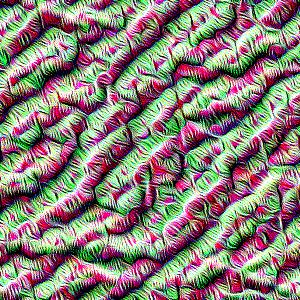

In [12]:
plotMixed(layers[idx[0]:idx[0]+1])

#Figure 3.1
Layer mixed3a_1x1_pre_relu/conv. Line patterns are found.

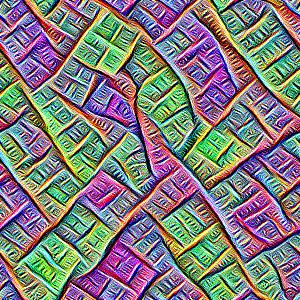

In [13]:
plotMixed(layers[idx[1]:idx[1]+1])

#Figure 3.2
Layer mixed3a_3x3_bottleneck_pre_relu/conv. Grid-like pattern with square spirals inside.

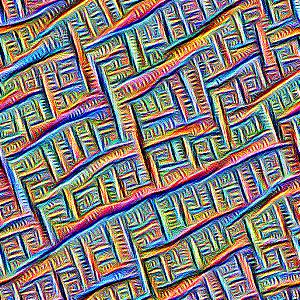

In [14]:
plotMixed(layers[idx[2]:idx[2]+1])

# Figure 3.3
Layer mixed3a_3x3_pre_relu/conv. More grids with square spirals.

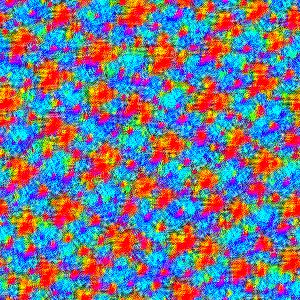

In [15]:
plotMixed(layers[idx[3]:idx[3]+1])

# Figure 3.4
Layer mixed3a_5x5_bottleneck_pre_relu/conv. Patches/blobs of red green, and blue.

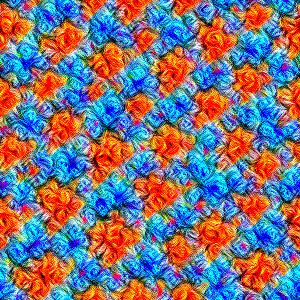

In [16]:
plotMixed(layers[idx[4]:idx[4]+1])

# Figure 3.5
Layer mixed3a_5x5_pre_relu/conv. More distinguished between red and blue. Flower-like

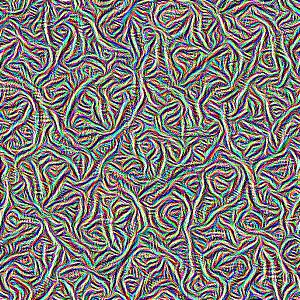

In [17]:
plotMixed(layers[idx[5]:idx[5]+1])

#Figure 3.6
Layer mixed3a_pool_reduce_pre_relu/conv. Small line pattern.

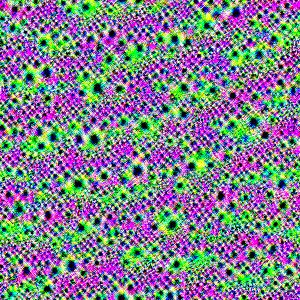

In [18]:
plotMixed(layers[idx[6]:idx[6]+1])

# Figure 3.7
Layer mixed3b_1x1_pre_relu/conv. Purple and green patches with black nuclei. Like microbes.

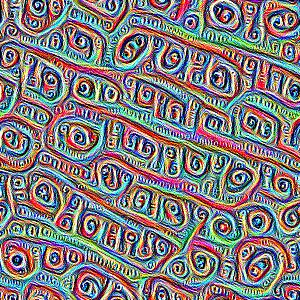

In [19]:
plotMixed(layers[idx[7]:idx[7]+1])

#Figure 3.8
Layer mixed3b_3x3_bottleneck_pre_relu/conv. More grid-like patterns with circular spirals.

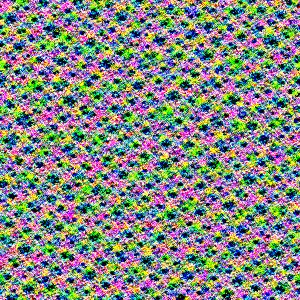

In [20]:
plotMixed(layers[idx[8]:idx[8]+1])

#Figure 3.9
Layer mixed3b_3x3_pre_relu/conv. Small flowers, like a large garden of purple, green, blue flowers.




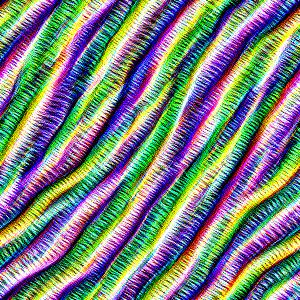

In [21]:
plotMixed(layers[idx[9]:idx[9]+1])

#Figure 3.10
Layer mixed3b_5x5_bottleneck_pre_relu/conv. Long strips of colors. Feather-like


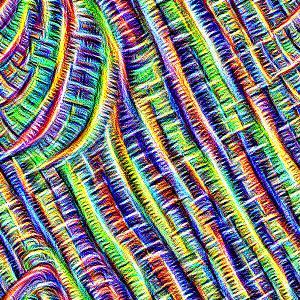

In [22]:
plotMixed(layers[idx[10]:idx[10]+1])

#Figure 3.11
Layer mixed3b_5x5_pre_relu/conv. Block-y strips.

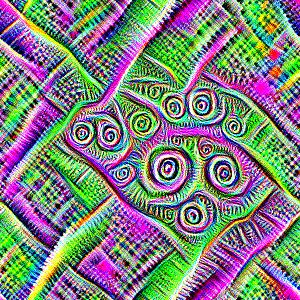

In [23]:
plotMixed(layers[idx[11]:idx[11]+1])

#Figure 3.12
Layer mixed3b_pool_reduce_pre_relu/conv. Long block-y stripes with sprials interspersed.

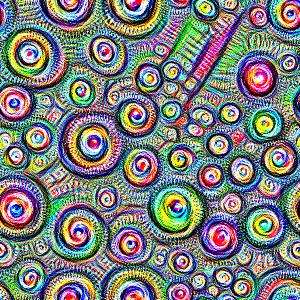

In [24]:
plotMixed(layers[idx[12]:idx[12]+1])

#Figure 3.13
Layer mixed4a_1x1_pre_relu/conv. Well defined spirals, starting to look eye-like.

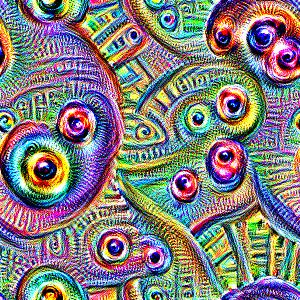

In [25]:
plotMixed(layers[idx[13]:idx[13]+1])

#Figure 3.14
Layer mixed4a_3x3_bottleneck_pre_relu/conv. One pair of eyes emerge.


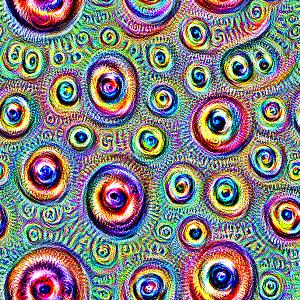

In [26]:
plotMixed(layers[idx[14]:idx[14]+1])

#Figure 3.15
Layer mixed4a_3x3_pre_relu/conv. More circular spirals, in a flow themselves.

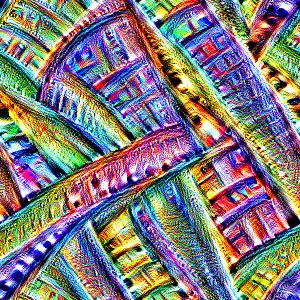

In [27]:
plotMixed(layers[idx[15]:idx[15]+1])

#Figure 3.16
Layer mixed4a_5x5_bottleneck_pre_relu/conv. Like snakes/worms piled on top of each other.

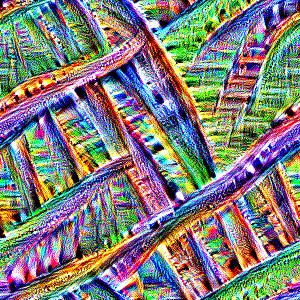

In [28]:
plotMixed(layers[idx[16]:idx[16]+1])

#Figure 3.17
Layer mixed4a_5x5_pre_relu/conv. More pile of snakes. Kind of DNA looking.

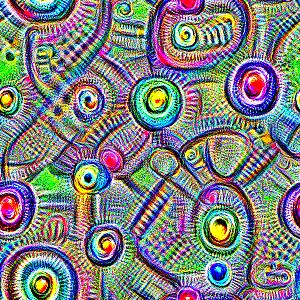

In [29]:
plotMixed(layers[idx[17]:idx[17]+1])

#Figure 3.18
Layer mixed4a_pool_reduce_pre_relu/conv. Circular spirals and dense eyes.

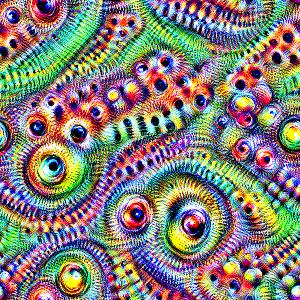

In [30]:
plotMixed(layers[idx[18]:idx[18]+1])

#Figure 3.19
Layer mixed4b_1x1_pre_relu/conv. Spirals and eyes.

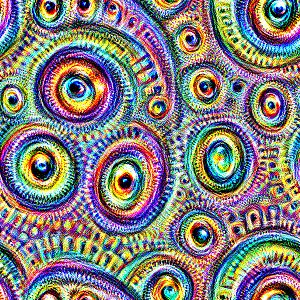

In [31]:
plotMixed(layers[idx[19]:idx[19]+1])

#Figure 3.20
Layer mixed4b_3x3_bottleneck_pre_relu/conv. Eyes and spirals.

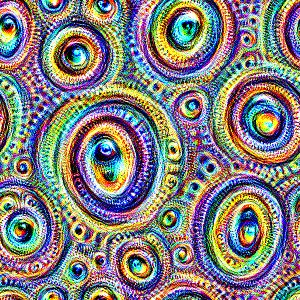

In [32]:
plotMixed(layers[idx[20]:idx[20]+1])

#Figure 3.21
Layer mixed4b_3x3_pre_relu/conv. Spirals and eyes.

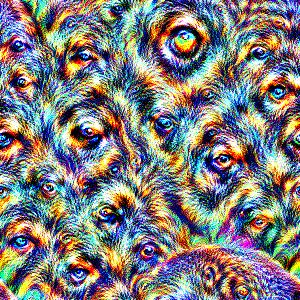

In [33]:
plotMixed(layers[idx[21]:idx[21]+1])

#Figure 3.22
Layer mixed4b_5x5_bottleneck_pre_relu/conv. Better defined eyes belonging to animals.

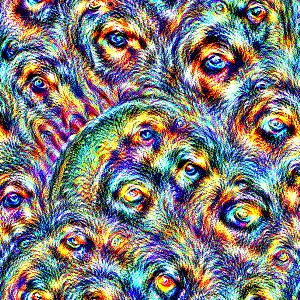

In [34]:
plotMixed(layers[idx[22]:idx[22]+1])

#Figure 3.23
Layer mixed4b_5x5_pre_relu/conv. Dense circles (eyes) with fur-like outline around them.

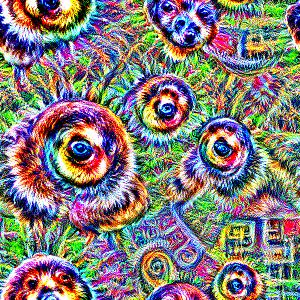

In [35]:
plotMixed(layers[idx[23]:idx[23]+1])

#Figure 3.24
Layer mixed4b_pool_reduce_pre_relu/conv. Spirals around eyes.

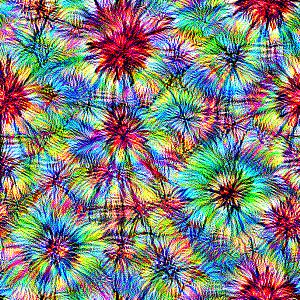

In [36]:
plotMixed(layers[idx[24]:idx[24]+1])

#Figure 3.25
Layer mixed4c_1x1_pre_relu/conv. Web like structure, with flowers at the nodes.

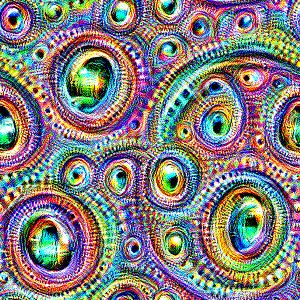

In [37]:
plotMixed(layers[idx[25]:idx[25]+1])

#Figure 3.26
Layer mixed4c_3x3_bottleneck_pre_relu/conv. Spirals around eyes.

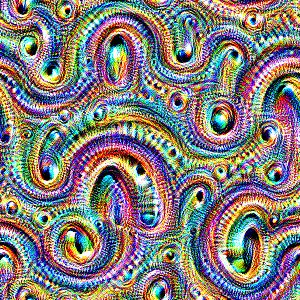

In [38]:
plotMixed(layers[idx[26]:idx[26]+1])

#Figure 3.27
Layer mixed4c_3x3_pre_relu/conv. Eyes and spirals.

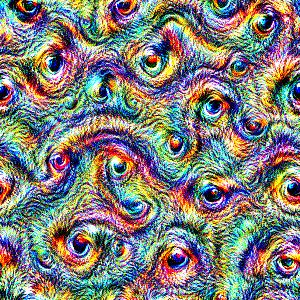

In [39]:
plotMixed(layers[idx[27]:idx[27]+1])

#Figure 3.28
Layer mixed4c_5x5_bottleneck_pre_relu/conv. Eyes placed on the spirals from Figure 3.27. Looking animal like.

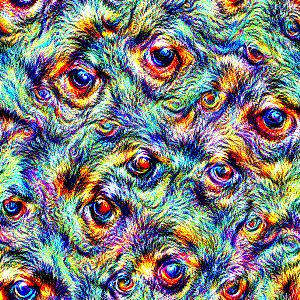

In [40]:
plotMixed(layers[idx[28]:idx[28]+1])

#Figure 3.29
Layer mixed4c_5x5_pre_relu/conv. Eyes

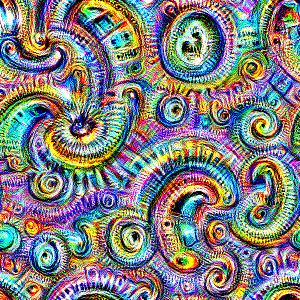

In [41]:
plotMixed(layers[idx[29]:idx[29]+1])

#Figure 3.30
Layer mixed4c_pool_reduce_pre_relu/conv. Spirals and eyes.

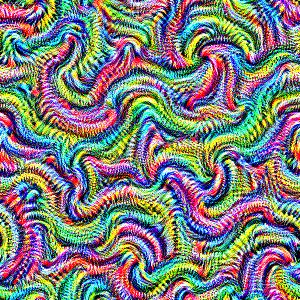

In [42]:
plotMixed(layers[idx[30]:idx[30]+1])

#Figure 3.31
Layer mixed4d_1x1_pre_relu/conv. Larger worms.

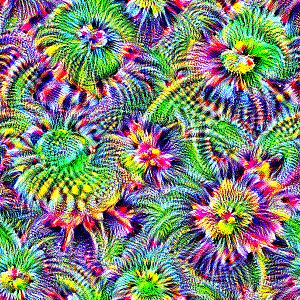

In [43]:
plotMixed(layers[idx[31]:idx[31]+1])

#Figure 3.32
Layer mixed4d_3x3_bottleneck_pre_relu/conv. Plants and flowers. Outline of a star shape.

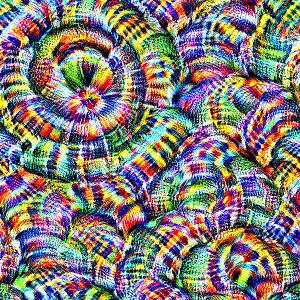

In [44]:
plotMixed(layers[idx[32]:idx[32]+1])

#Figure 3.33
Layer mixed4d_3x3_pre_relu/conv. A couple of underfed foxes around some twigs.

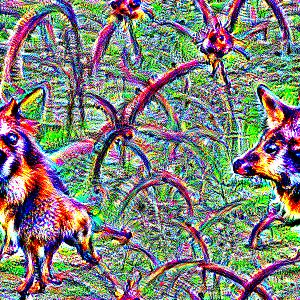

In [45]:
plotMixed(layers[idx[33]:idx[33]+1])

#Figure 3.34
Layer mixed4d_5x5_bottleneck_pre_relu/conv. A couple of foxes!

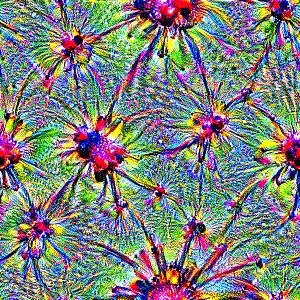

In [46]:
plotMixed(layers[idx[34]:idx[34]+1])

#Figure 3.35
Layer mixed4d_5x5_pre_relu/conv. Berry plants

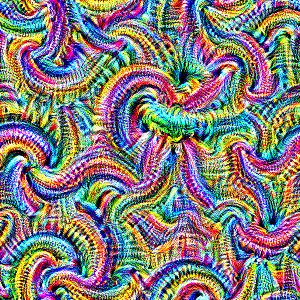

In [47]:
plotMixed(layers[idx[35]:idx[35]+1])

#Figure 3.36
Layer mixed4d_pool_reduce_pre_relu/conv. Worms.

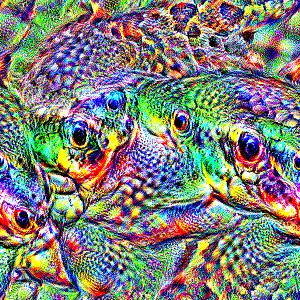

In [48]:
plotMixed(layers[idx[36]:idx[36]+1])

#Figure 3.37
Layer mixed4e_1x1_pre_relu/conv. Eyes on fish or birds?

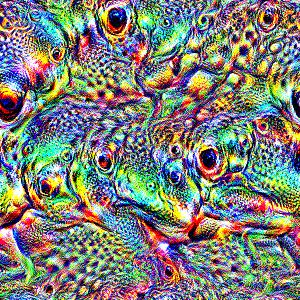

In [49]:
plotMixed(layers[idx[37]:idx[37]+1])

#Figure 3.38
Layer mixed4e_3x3_bottleneck_pre_relu/conv. Birds and fish emerging.

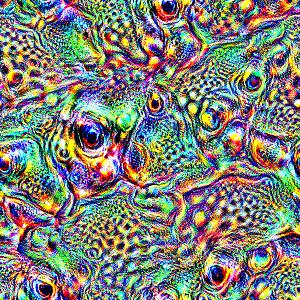

In [50]:
plotMixed(layers[idx[38]:idx[38]+1])

#Figure 3.39
Layer mixed4e_3x3_pre_relu/conv. Very trippy/psychedelic birds, and spots.

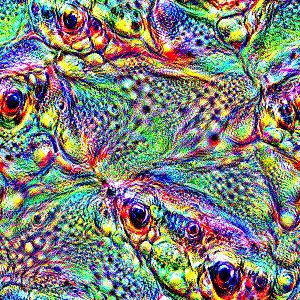

In [51]:
plotMixed(layers[idx[39]:idx[39]+1])

#Figure 3.40
Layer mixed4e_5x5_bottleneck_pre_relu/conv. Eyes and partitioned sections.

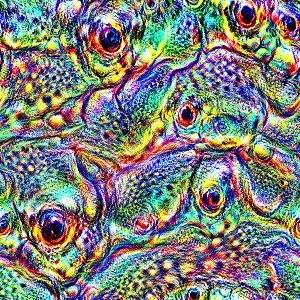

In [52]:
plotMixed(layers[idx[40]:idx[40]+1])

#Figure 3.41
Layer mixed4e_5x5_pre_relu/conv. Menacing bird eyes. 

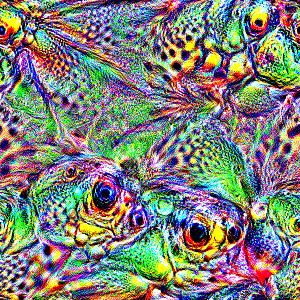

In [53]:
plotMixed(layers[idx[41]:idx[41]+1])

#Figure 3.42
Layer mixed4e_pool_reduce_pre_relu/conv. Frog eyes.

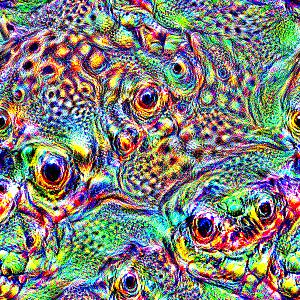

In [54]:
plotMixed(layers[idx[42]:idx[42]+1])

#Figure 3.43
Layer mixed5a_1x1_pre_relu/conv. Peacock feather looking with frog in bottom right.

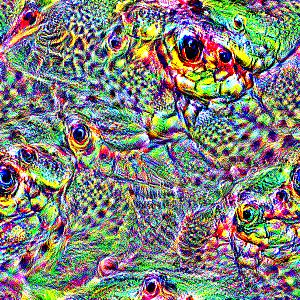

In [55]:
plotMixed(layers[idx[43]:idx[43]+1])

#Figure 3.44
Layer mixed5a_3x3_bottleneck_pre_relu/conv. Alien-bulldog looking creature in the right side of the image. 

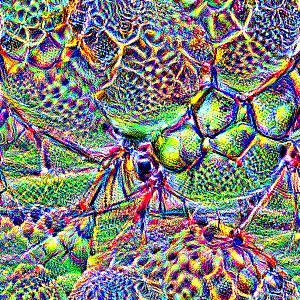

In [56]:
plotMixed(layers[idx[44]:idx[44]+1])

#Figure 3.45
Layer mixed5a_3x3_pre_relu/conv. Lots of partitioned blobs, tree looking, with links between them.

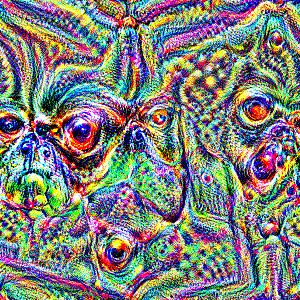

In [57]:
plotMixed(layers[idx[45]:idx[45]+1])

#Figure 3.46
Layer mixed5a_5x5_bottleneck_pre_relu/conv. Alien looking bulldog in the left side of the image.

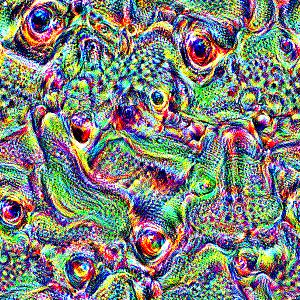

In [58]:
plotMixed(layers[idx[46]:idx[46]+1])

#Figure 3.47
Layer mixed5a_5x5_pre_relu/conv. Eyes. 

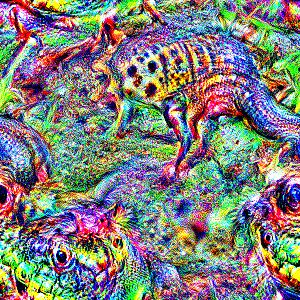

In [59]:
plotMixed(layers[idx[47]:idx[47]+1])

#Figure 3.48
Layer mixed5a_pool_reduce_pre_relu/conv. Large creature in the top center

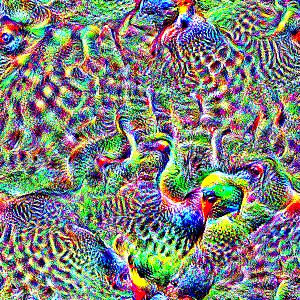

In [60]:
plotMixed(layers[idx[48]:idx[48]+1])

#Figure 3.49
Layer mixed5b_1x1_pre_relu/conv. I don't even know

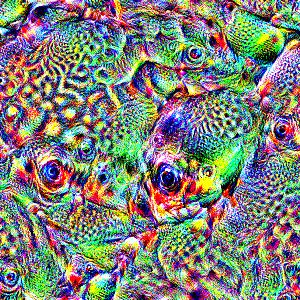

In [61]:
plotMixed(layers[idx[49]:idx[49]+1])

#Figure 3.50
Layer mixed5b_3x3_bottleneck_pre_relu/conv. Eyers and fish and birds.

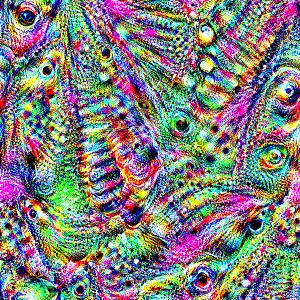

In [62]:
plotMixed(layers[idx[50]:idx[50]+1])

#Figure 3.51
Layer mixed5b_3x3_pre_relu/conv. Scales/feathers and eyes.

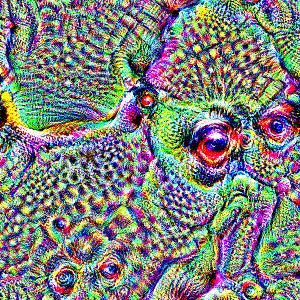

In [63]:
plotMixed(layers[idx[51]:idx[51]+1])

#Figure 3.52
Layer mixed5b_5x5_bottleneck_pre_relu/conv. Alien bull dog eyes are back in the right

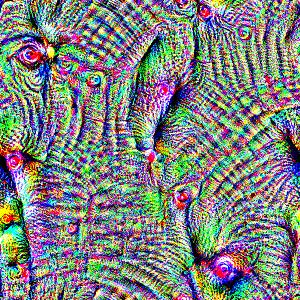

In [64]:
plotMixed(layers[idx[52]:idx[52]+1])

#Figure 3.53
Layer mixed5b_5x5_pre_relu/conv. Unsure

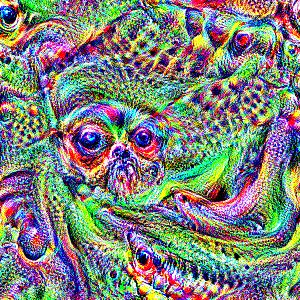

In [65]:
plotMixed(layers[idx[53]:idx[53]+1])

#Figure 3.54
Layer mixed5b_pool_reduce_pre_relu/conv. Bulldog in the center.

# Task 4:  Qalitatively describe
based on your understanding and reading, why the layers show different features and what it the "kind" of features extracted in the earler layers vs the later ones.


Some layers are picking out small scale structures, like edges/basic shapes. Other layers are looking for complex structures. When the easily discernable animals are created these are coming from the complex structure layers. 

# Task 5: Load your chosen image 
must be at least 600 pixels in each size

In [66]:
from google.colab import files
uploaded = files.upload()

Saving Puppy.jpg to Puppy.jpg


In [67]:

if type(uploaded) is not dict: uploaded = uploaded.files  ## Deal with filedit versions
file_contents = uploaded[list(uploaded.keys())[0]]


In [68]:
tf.io.decode_image(file_contents)

<tf.Tensor 'decode_image/DecodeImage:0' shape=<unknown> dtype=uint8>

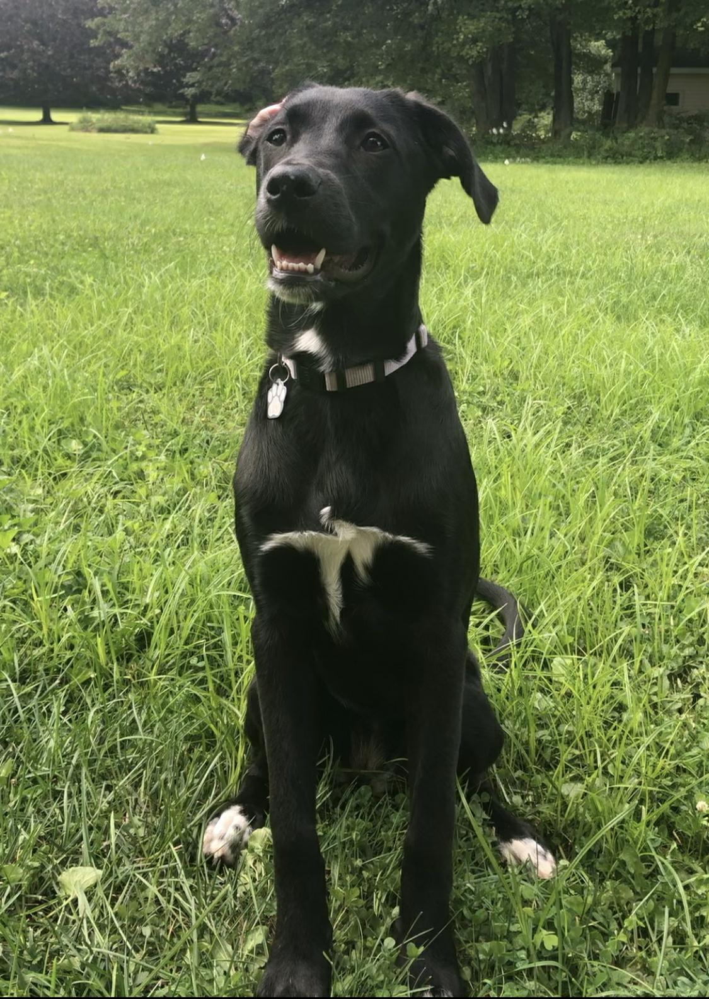

In [69]:
img0 = sess.run(tf.io.decode_image(file_contents))
showarray(img0)


#Figure 4
My dog Juno

# Task 6: shrink it to 600 pixels along the x axis by subsampling 


In [70]:
img0.shape

(1585, 1125, 3)

In [71]:
basewidth = 600
img1 = img0.copy()

if img0.shape[0] > basewidth:
  step = int(float(img0.shape[0] / basewidth))
  if img0.shape[-1] == 4:
    img0 = img0[:,:,:3]

  img1 = img0.copy()
  img1 = img1[::step]
elif img0.shape[0] < basewidth:
  import scipy
  img1 = scipy.ndimage.zoom(img0, zoom=(2, 1,1), order=1)





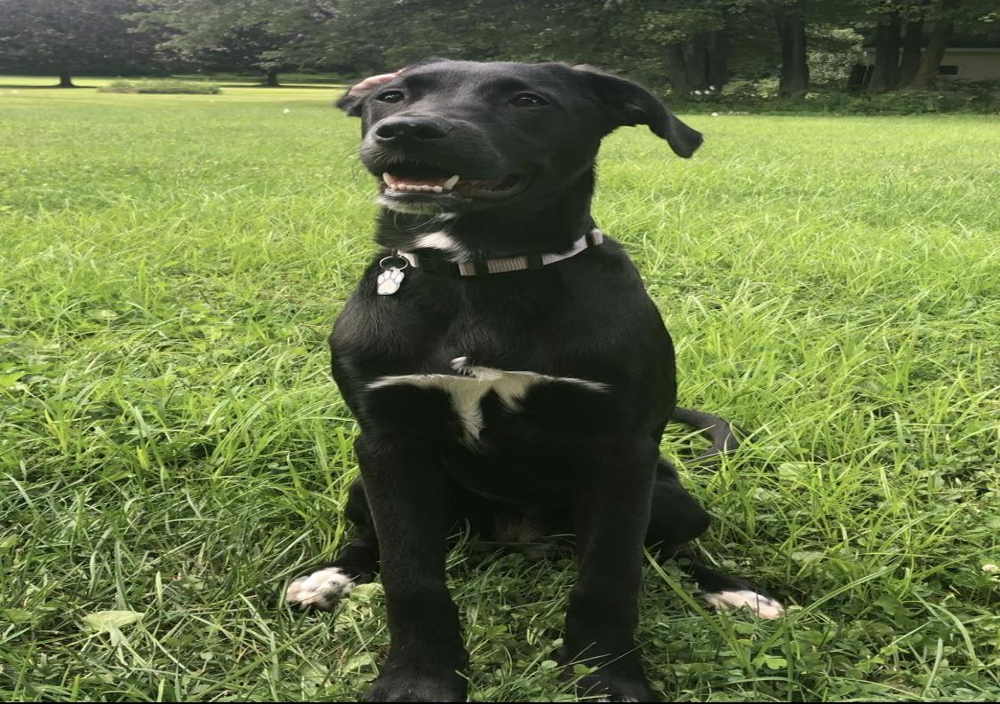

In [72]:
showarray(img1)

#Figure 5
Scaled down Juno

# Task 7: Repeat step 4, DeepDream, with your image. 
Save the layer you like. Upload tha original and modified image to the readme file of your DSPS repo



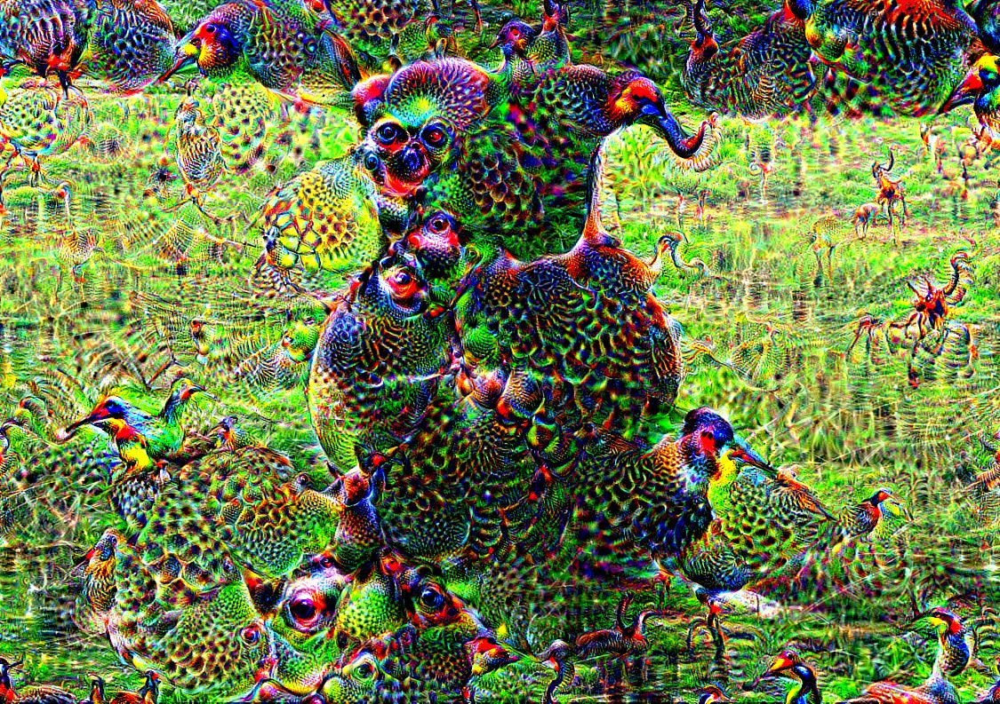

In [73]:
octave_n = 5 #@param {type:"slider", max: 10}
octave_scale = 1.4 #@param {type:"number"}
iter_n = 20 #@param {type:"slider", max: 50}
strength = 645 #@param {type:"slider", max: 1000}
layer = "mixed5a"  #@param ["mixed3a", "mixed3b", "mixed4a", "mixed4c", "mixed5a"]

final = render_deepdream(tf.square(T(layer)), img1)

#Figure 6
Example of Juno covered in outlandish objects. There appears to be a skull on the left of Juno's face. 

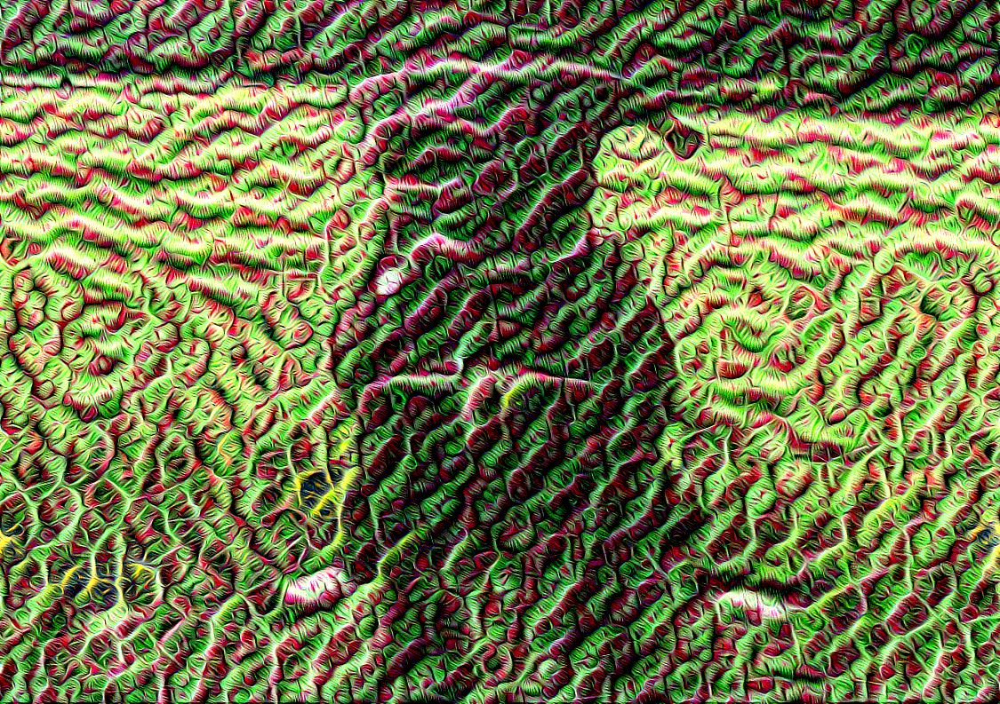

In [74]:
plotMixed(layers[idx[0]:idx[0]+1], img1)

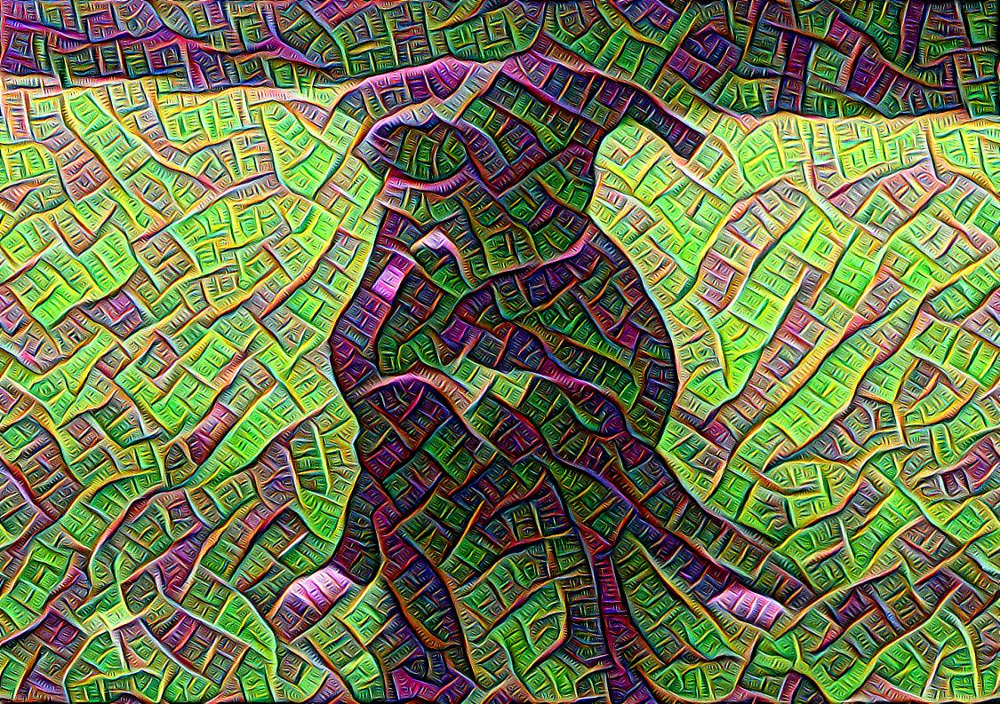

In [75]:
plotMixed(layers[idx[1]:idx[1]+1], img1)

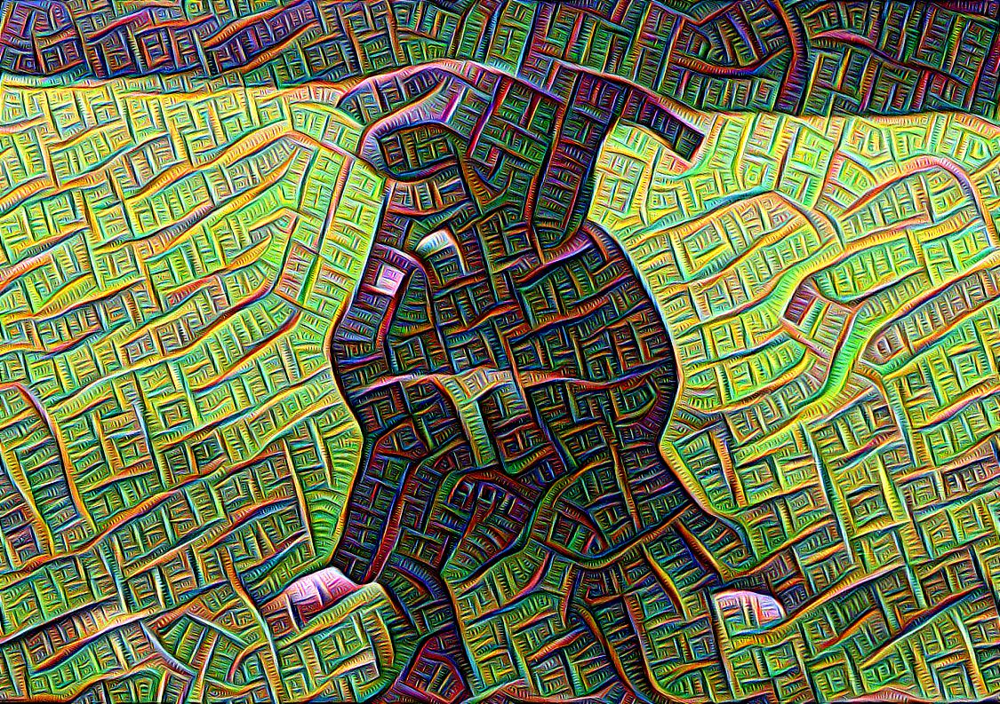

In [76]:
plotMixed(layers[idx[2]:idx[2]+1], img1)

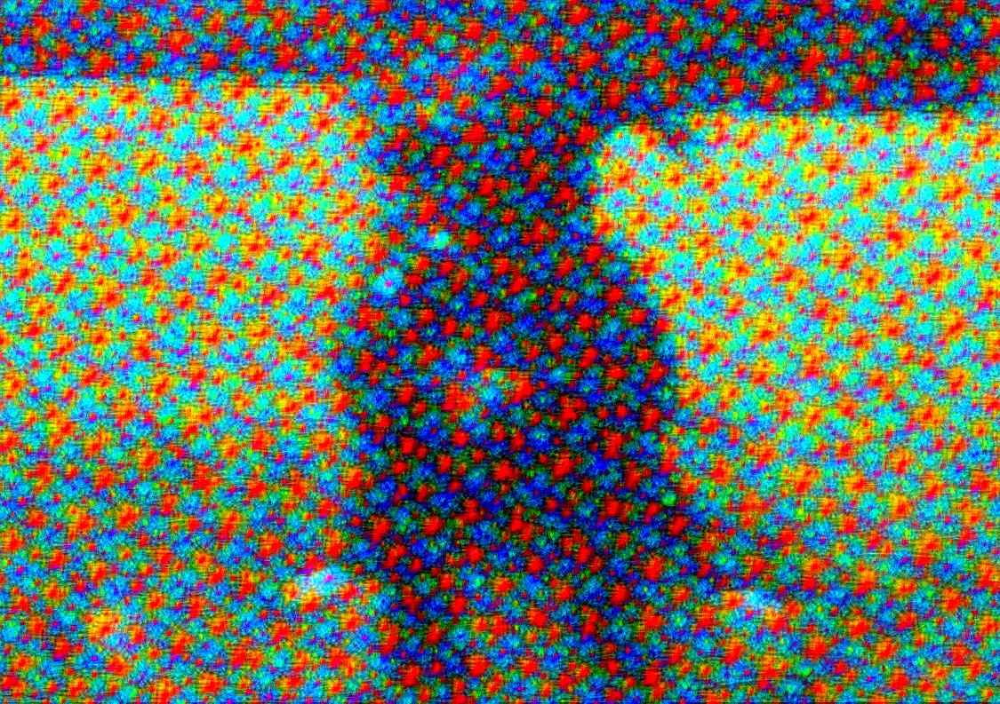

In [77]:
plotMixed(layers[idx[3]:idx[3]+1], img1)

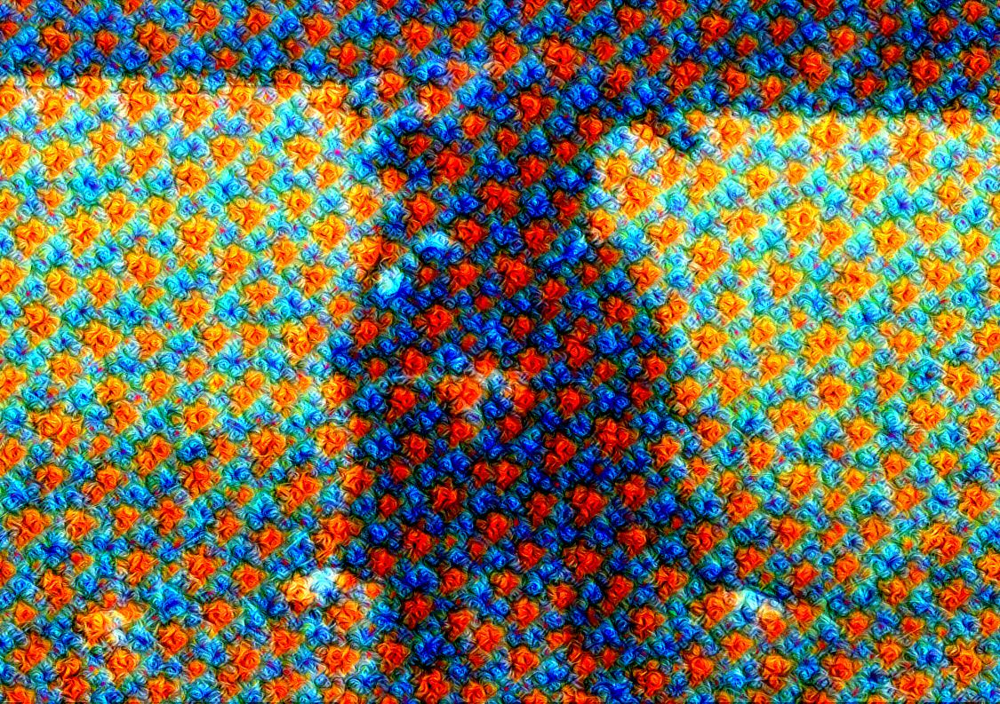

In [78]:
plotMixed(layers[idx[4]:idx[4]+1], img1)

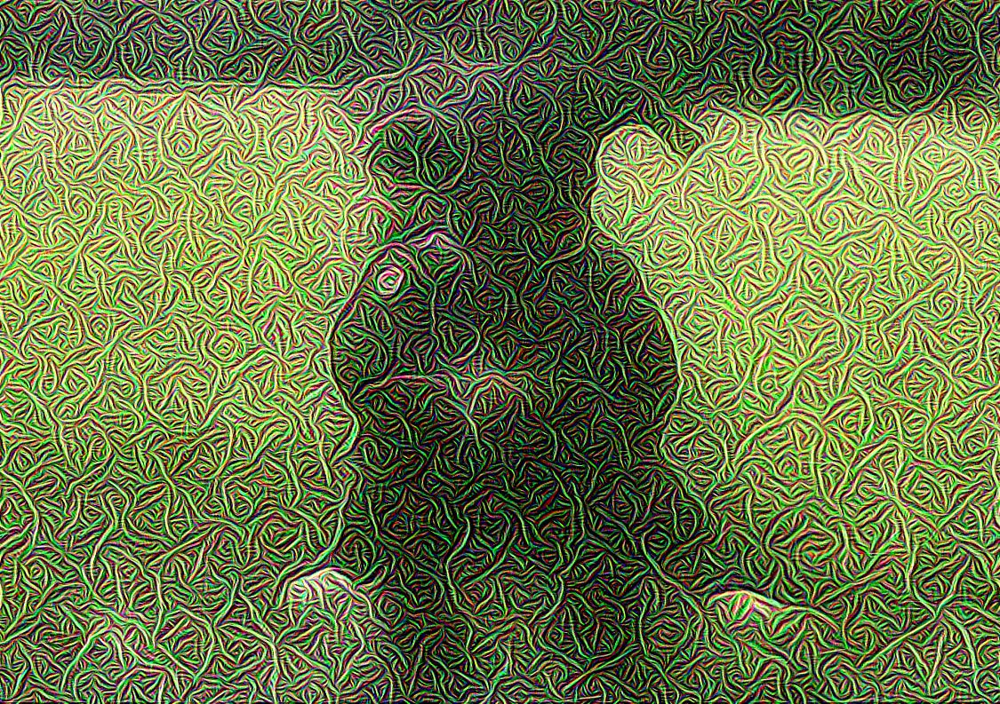

In [79]:
plotMixed(layers[idx[5]:idx[5]+1], img1)

Figure 7.1
The previous 6 images belong to the 3a series.

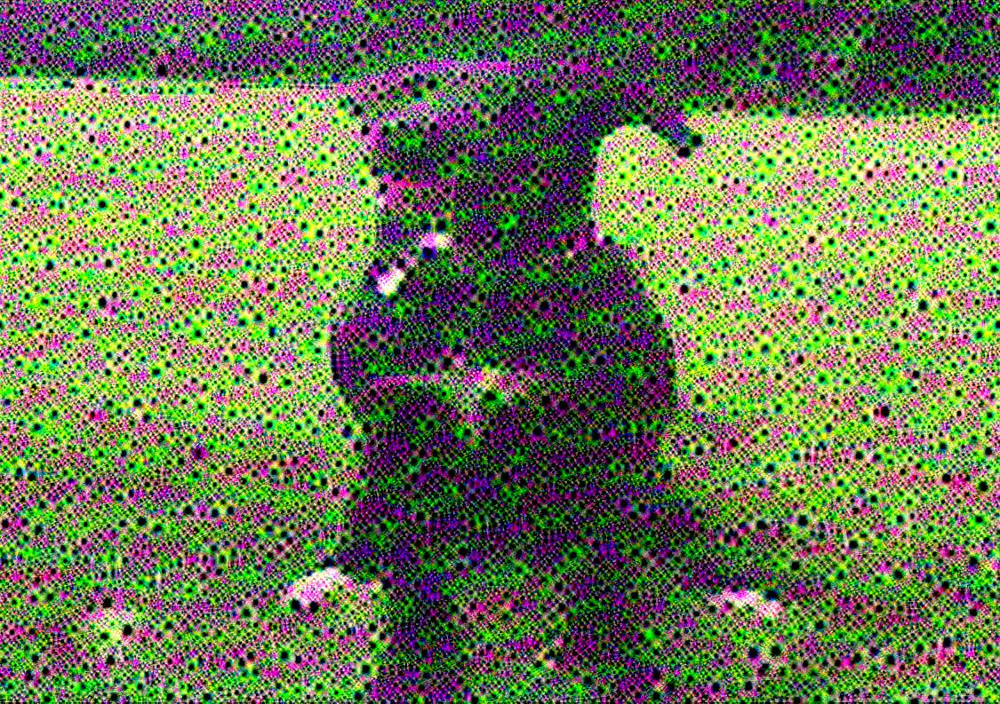

In [80]:
plotMixed(layers[idx[6]:idx[6]+1], img1)

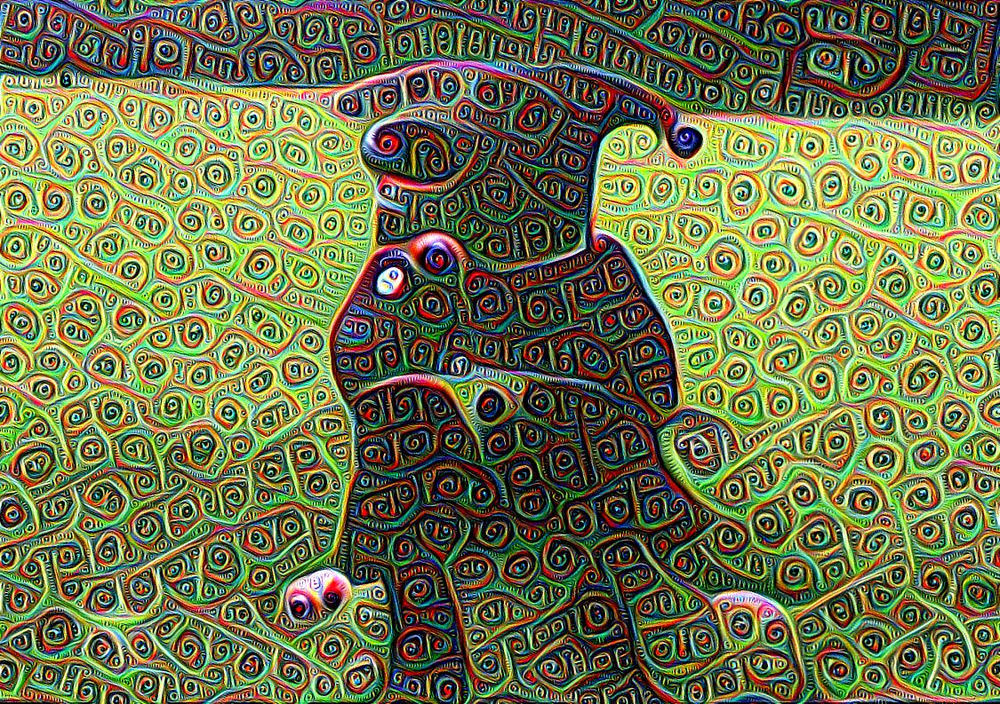

In [81]:
plotMixed(layers[idx[7]:idx[7]+1], img1)

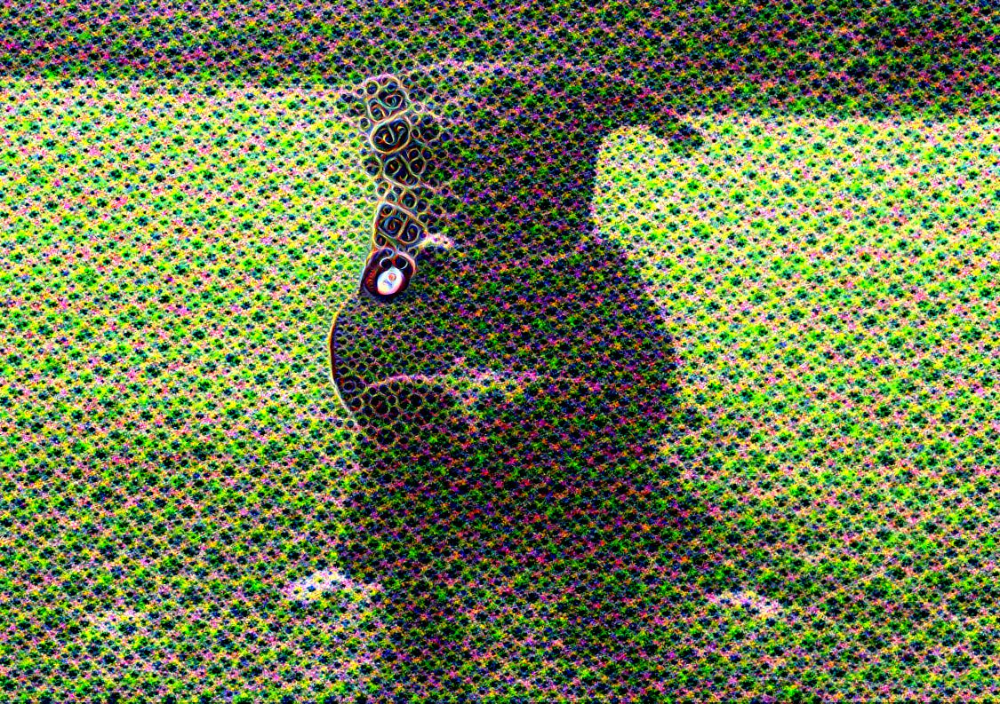

In [82]:
plotMixed(layers[idx[8]:idx[8]+1], img1)

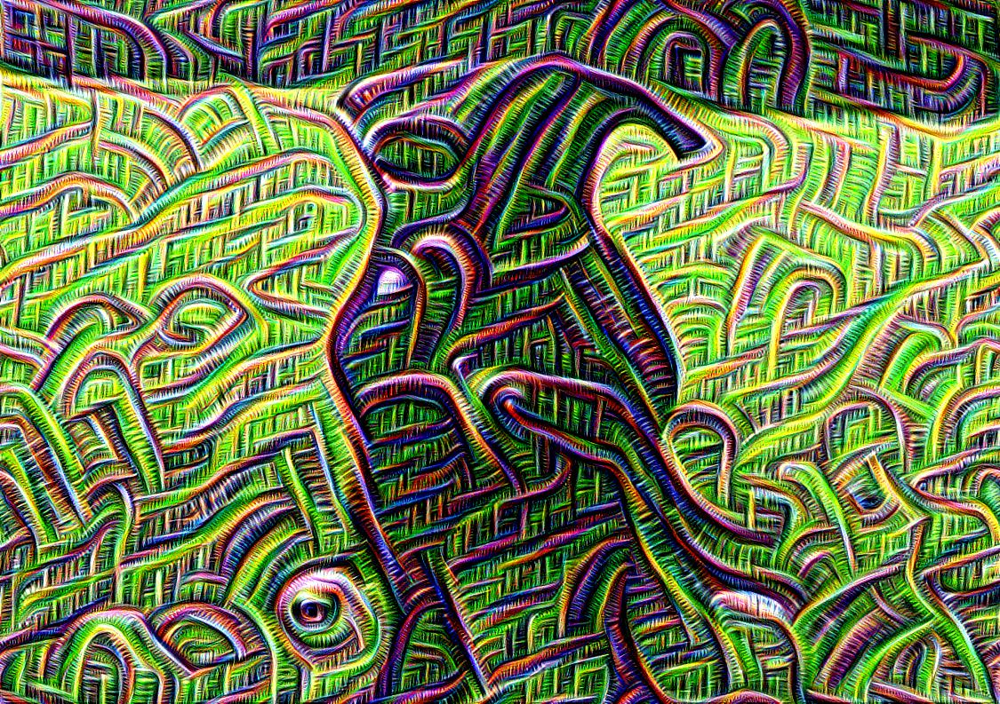

In [83]:
plotMixed(layers[idx[9]:idx[9]+1], img1)

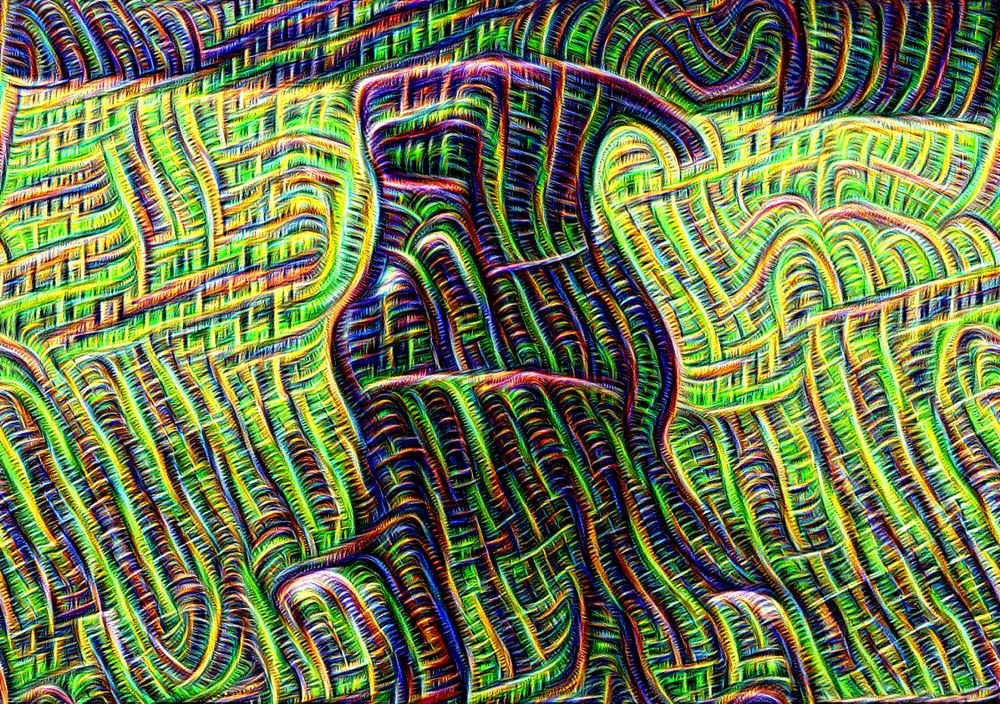

In [84]:
plotMixed(layers[idx[10]:idx[10]+1], img1)

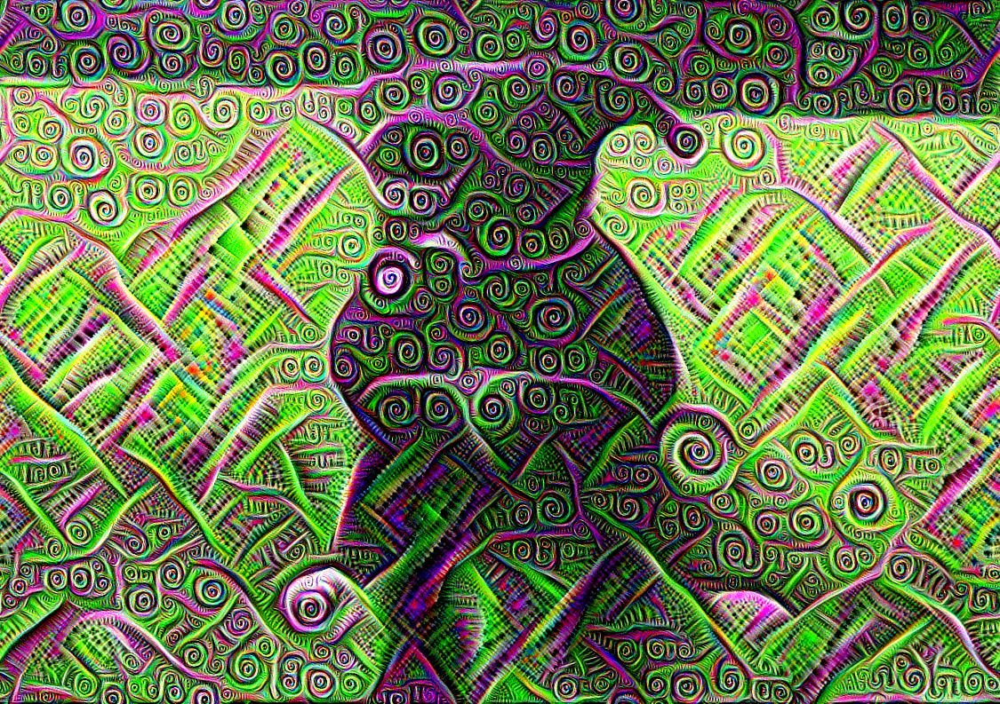

In [85]:
plotMixed(layers[idx[11]:idx[11]+1], img1)

#Figure 7.2
The previous 6 images belong to the 3b series.

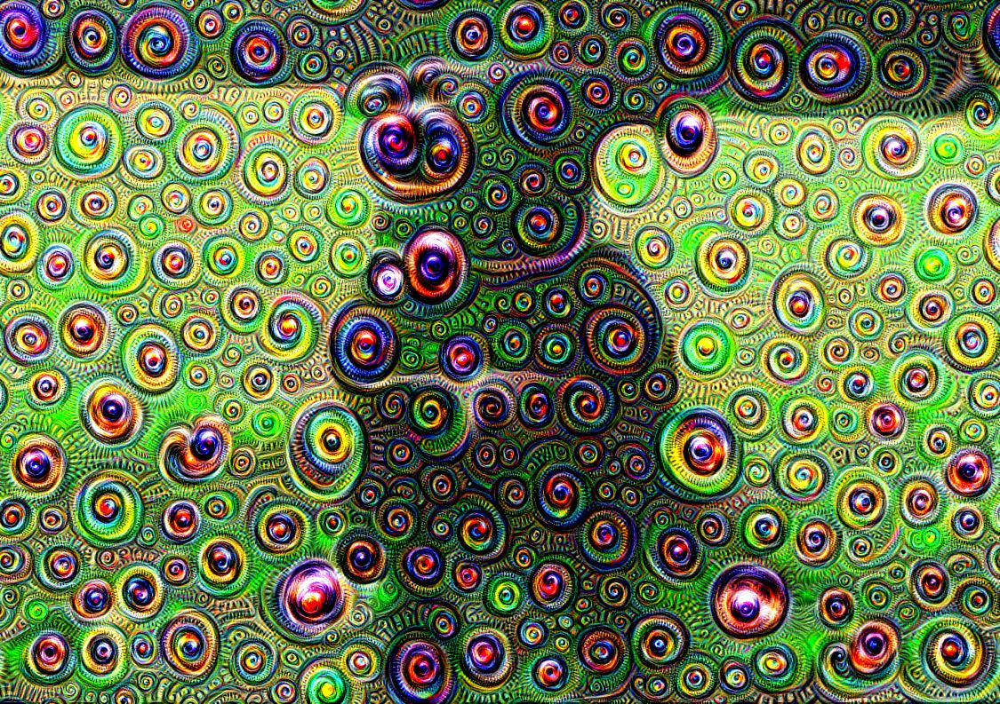

In [86]:
plotMixed(layers[idx[12]:idx[12]+1], img1)

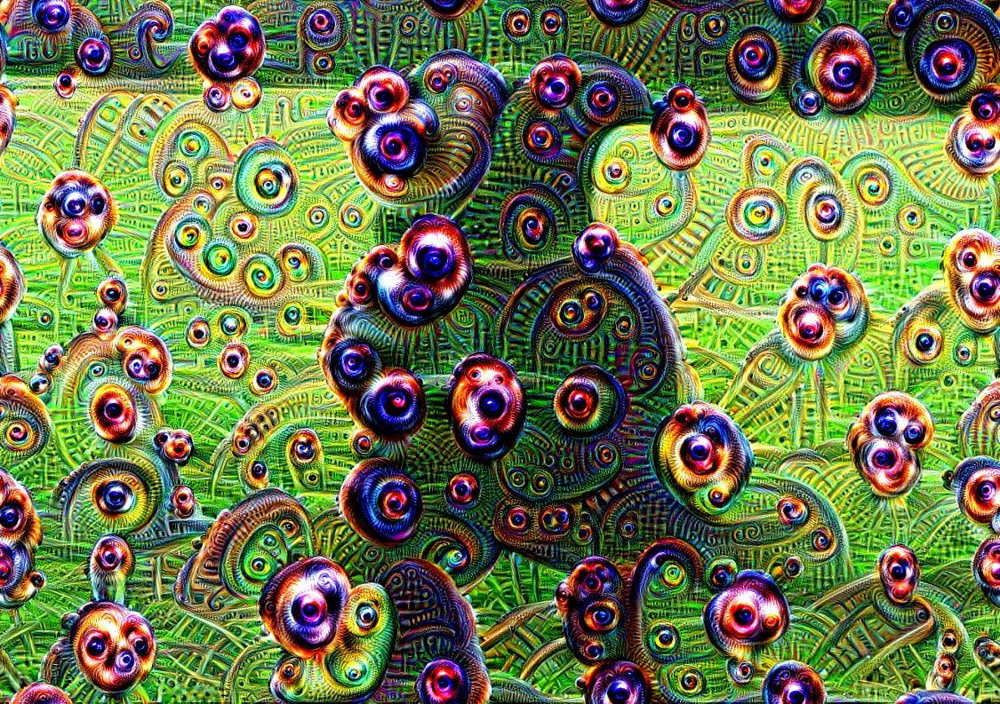

In [87]:
plotMixed(layers[idx[13]:idx[13]+1], img1)

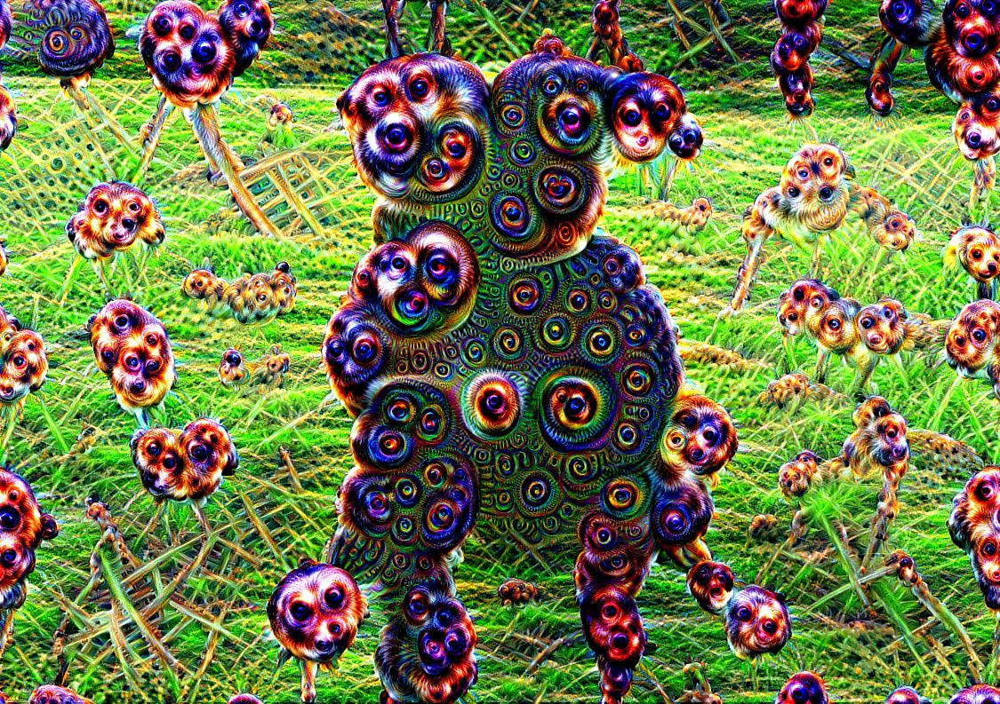

In [88]:
plotMixed(layers[idx[14]:idx[14]+1], img1)

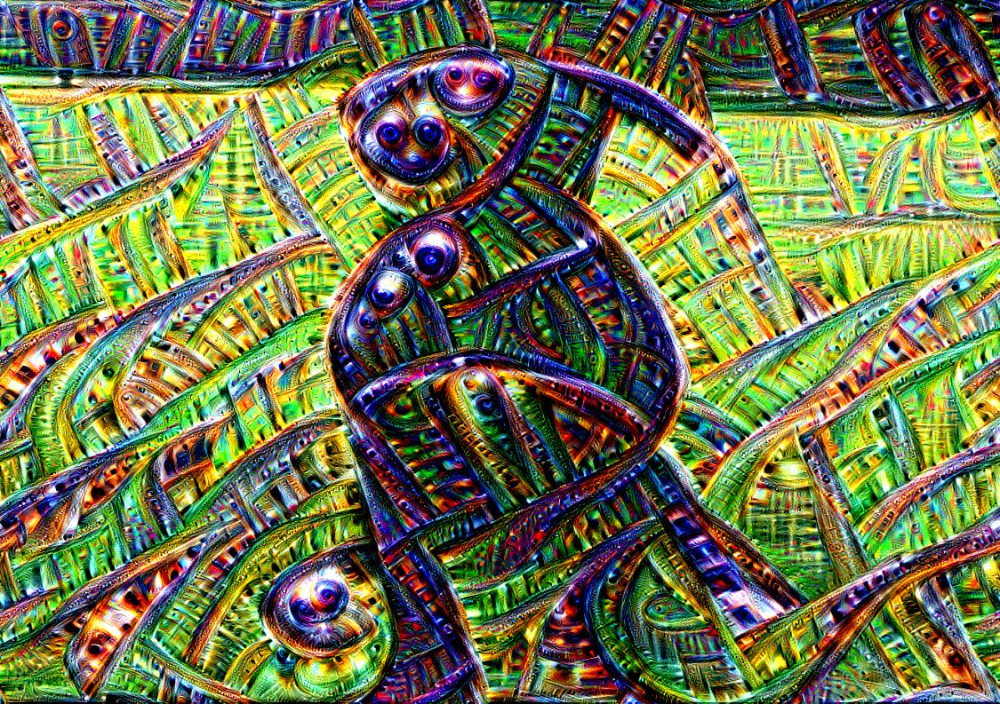

In [89]:
plotMixed(layers[idx[15]:idx[15]+1], img1)

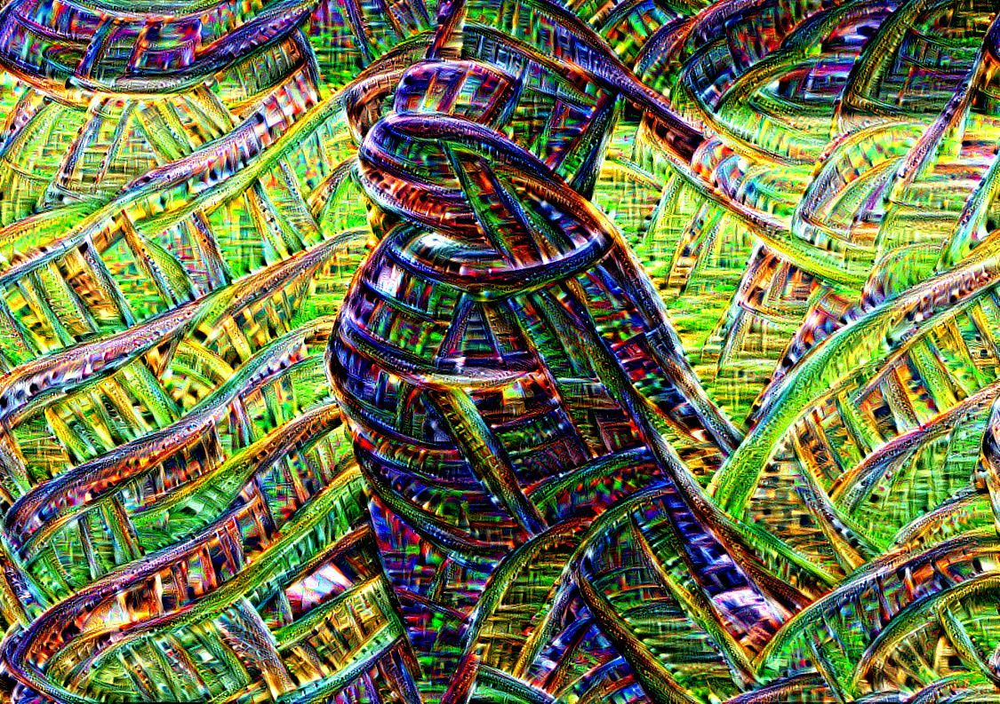

In [90]:
plotMixed(layers[idx[16]:idx[16]+1], img1)

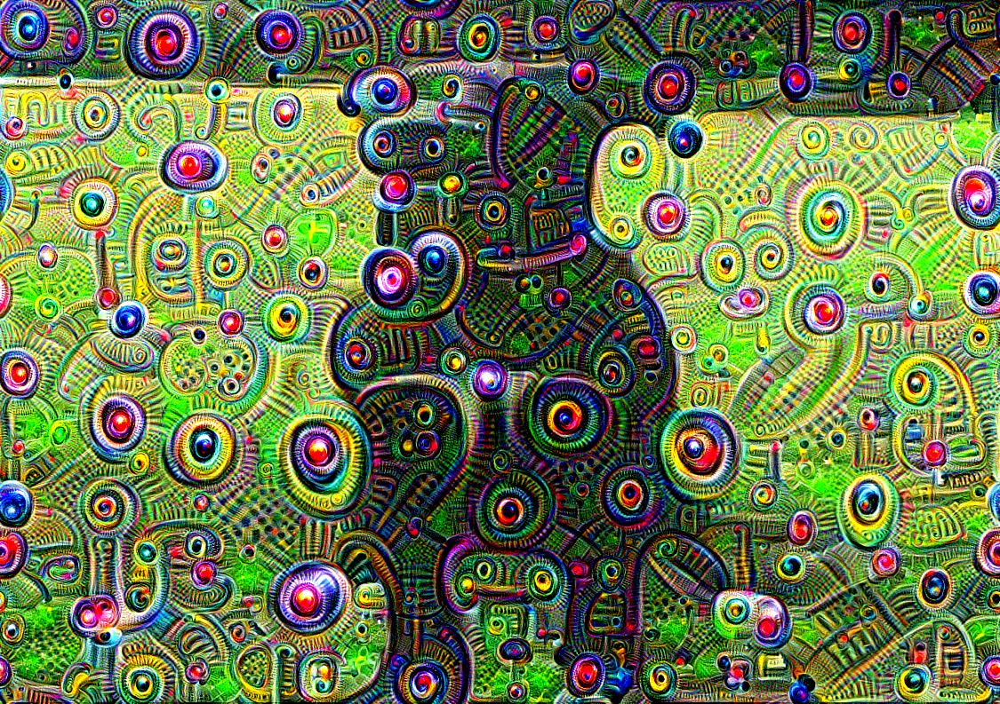

In [91]:
plotMixed(layers[idx[17]:idx[17]+1], img1)

#Figure 7.3
The previous 6 images belong to the 4a series.

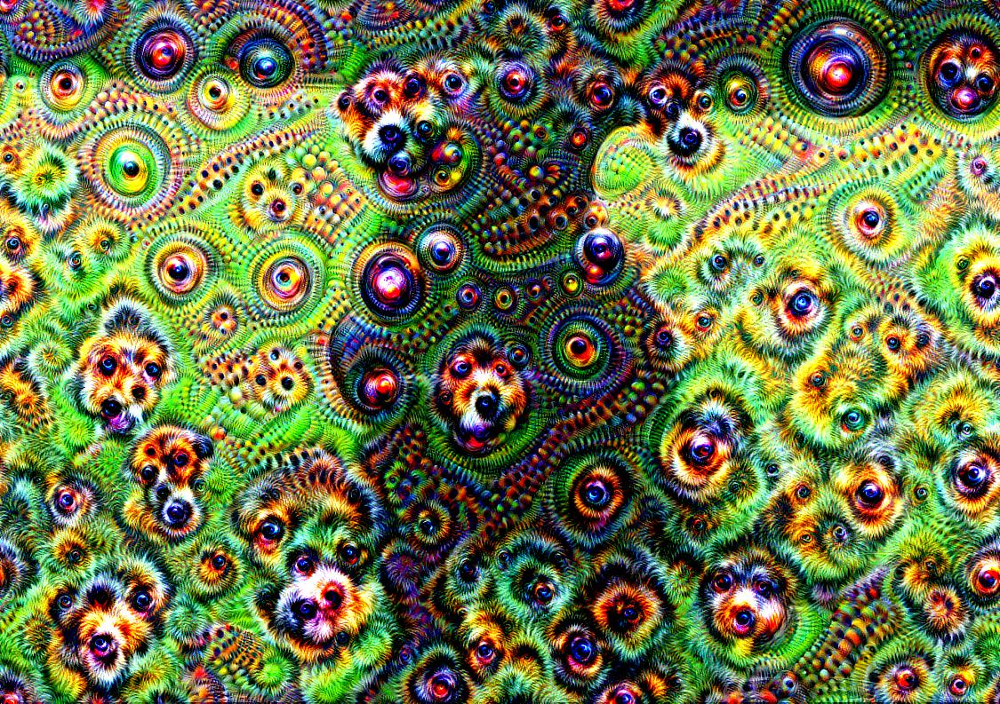

In [92]:
plotMixed(layers[idx[18]:idx[18]+1], img1)

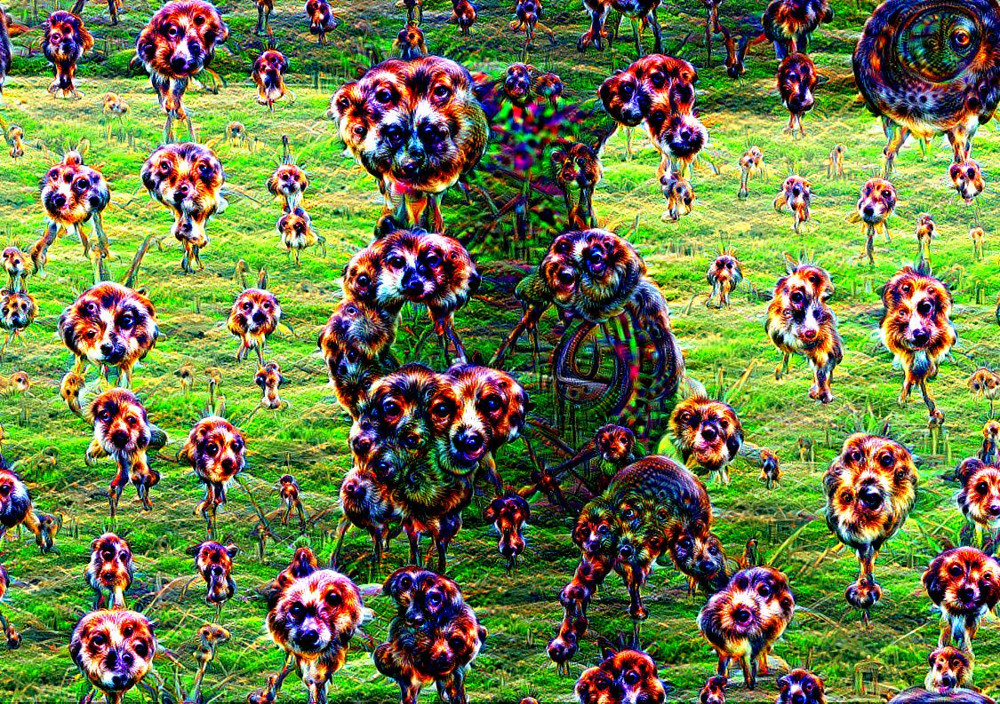

In [93]:
plotMixed(layers[idx[19]:idx[19]+1], img1)

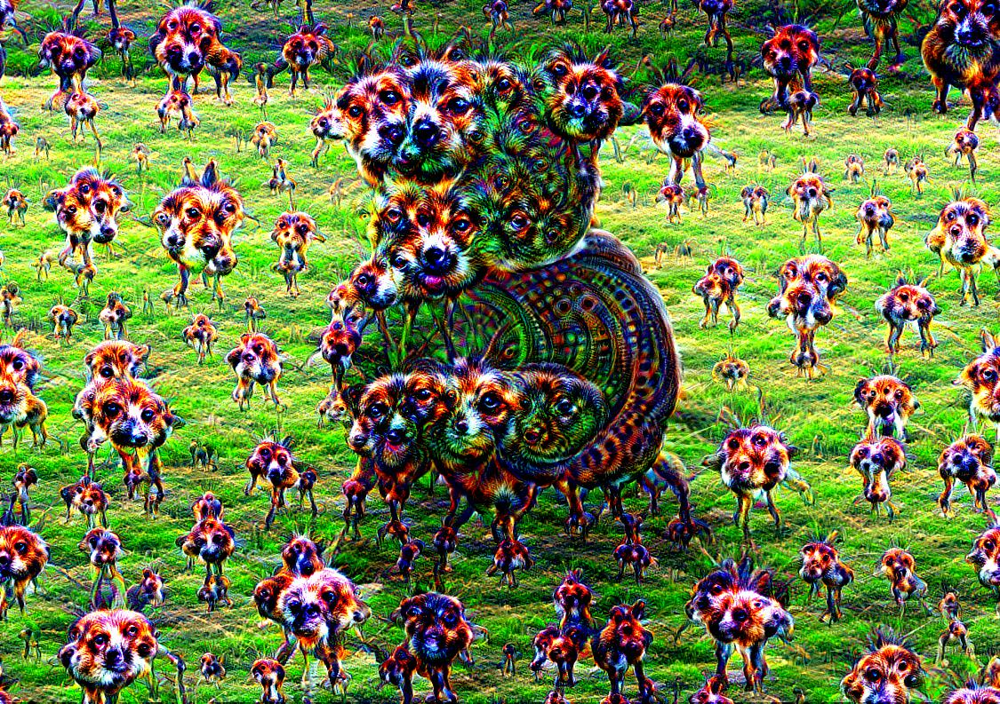

In [94]:
plotMixed(layers[idx[20]:idx[20]+1], img1)

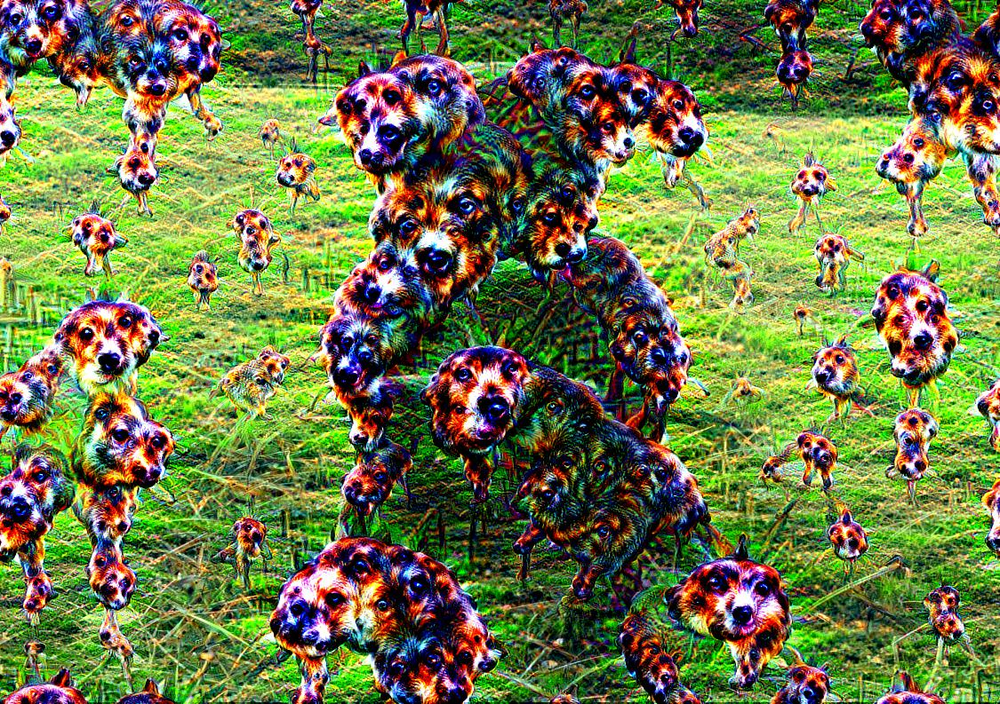

In [95]:
plotMixed(layers[idx[21]:idx[21]+1], img1)

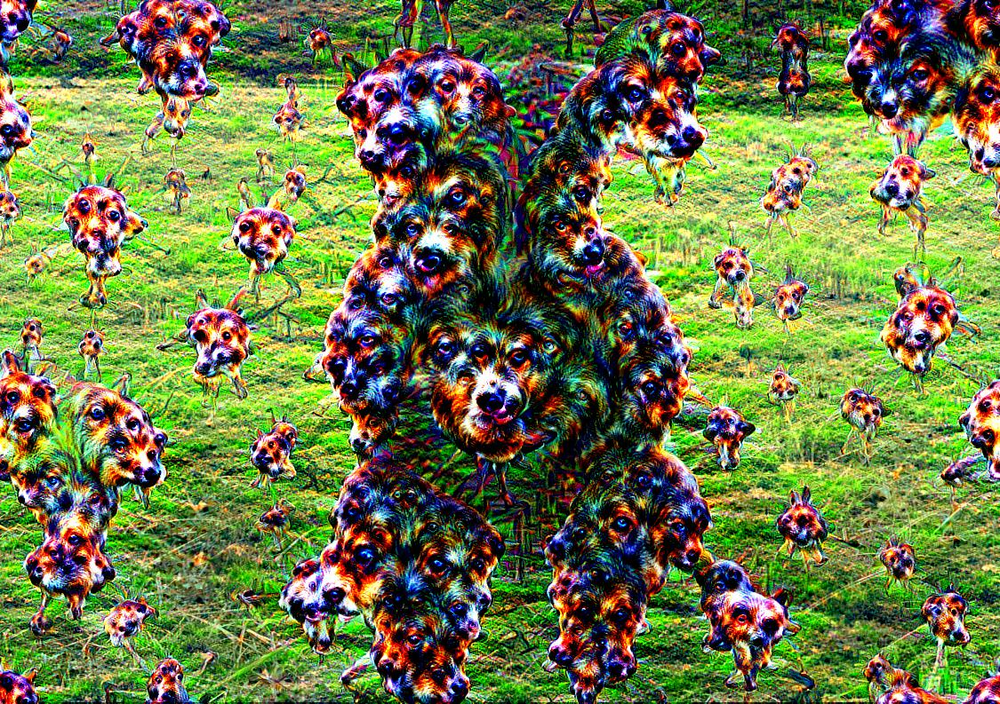

In [96]:
plotMixed(layers[idx[22]:idx[22]+1], img1)

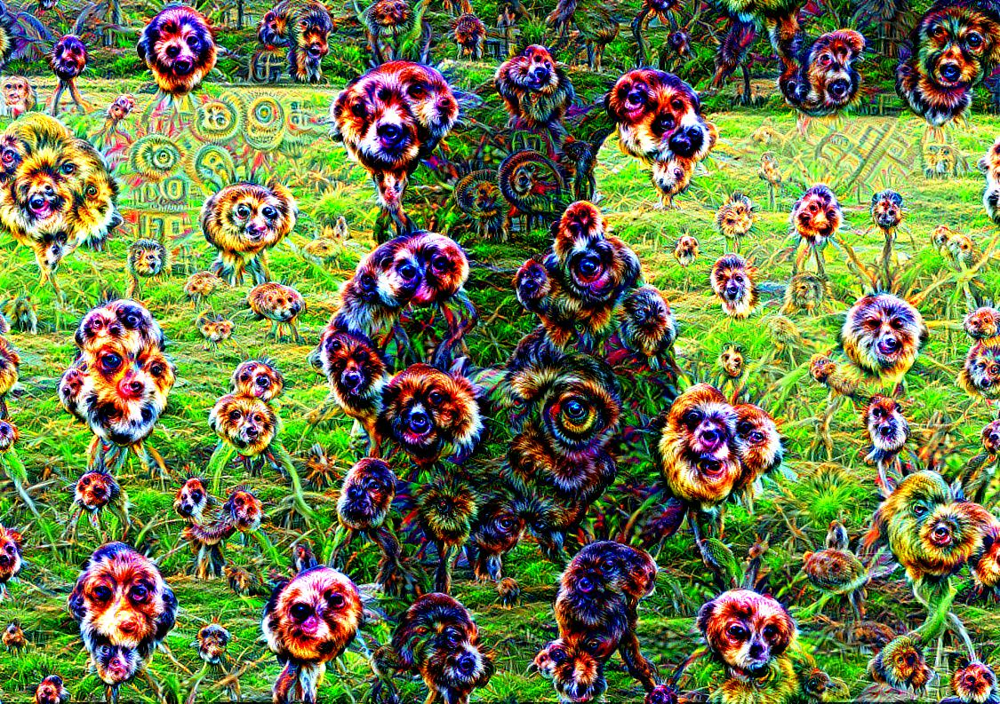

In [97]:
plotMixed(layers[idx[23]:idx[23]+1], img1)

#Figure 7.4
The previous 6 images belong to the 4b series.

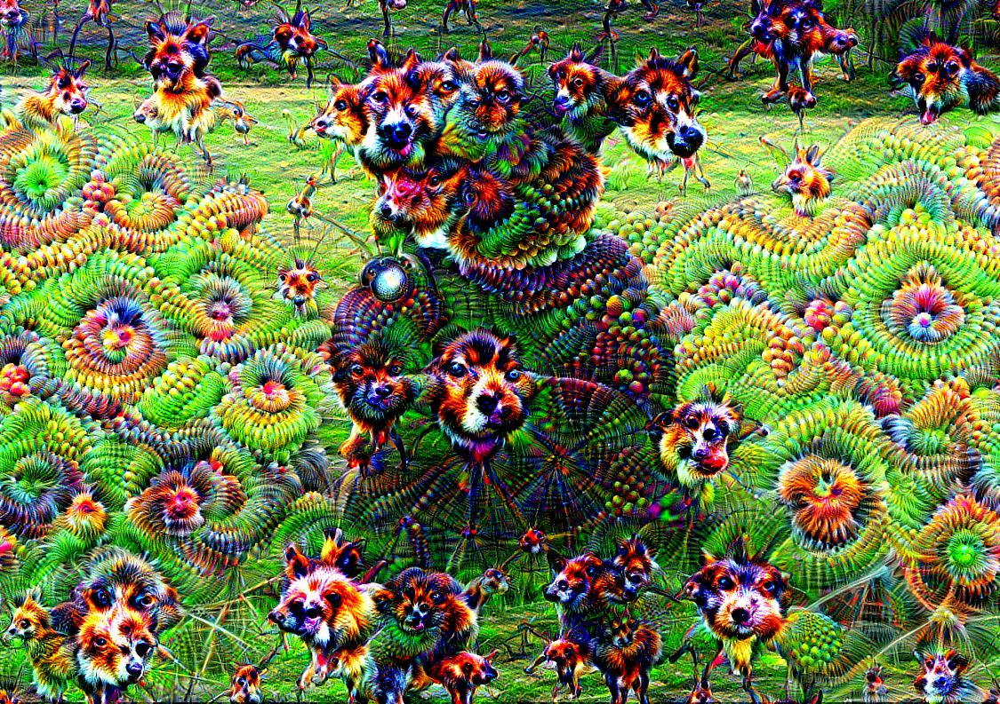

In [98]:
plotMixed(layers[idx[24]:idx[24]+1], img1)

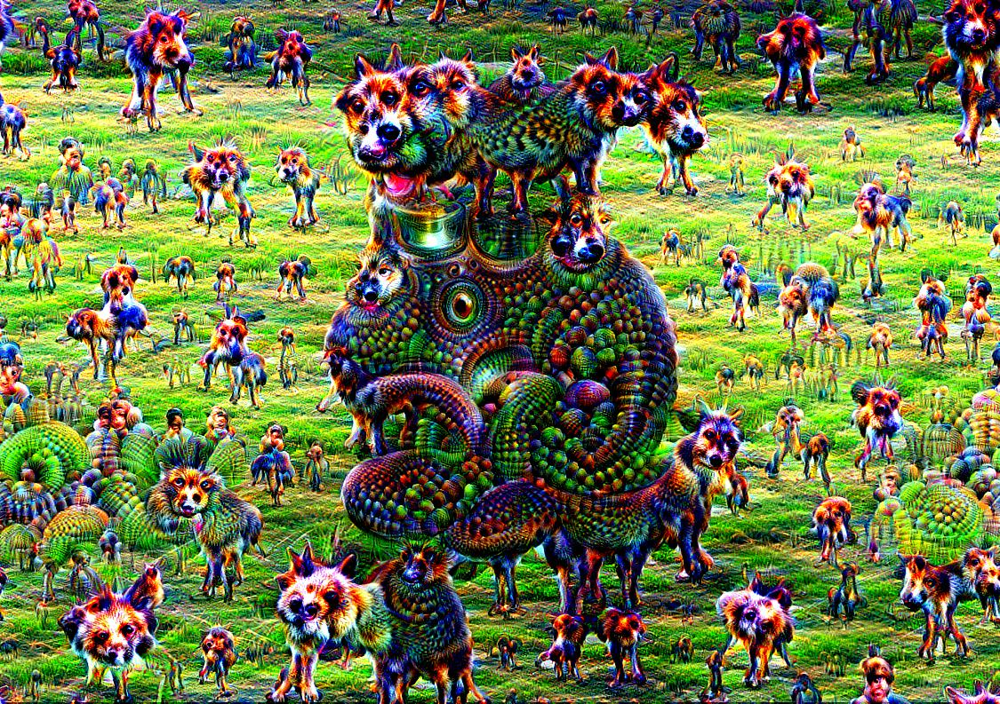

In [99]:
plotMixed(layers[idx[25]:idx[25]+1], img1)

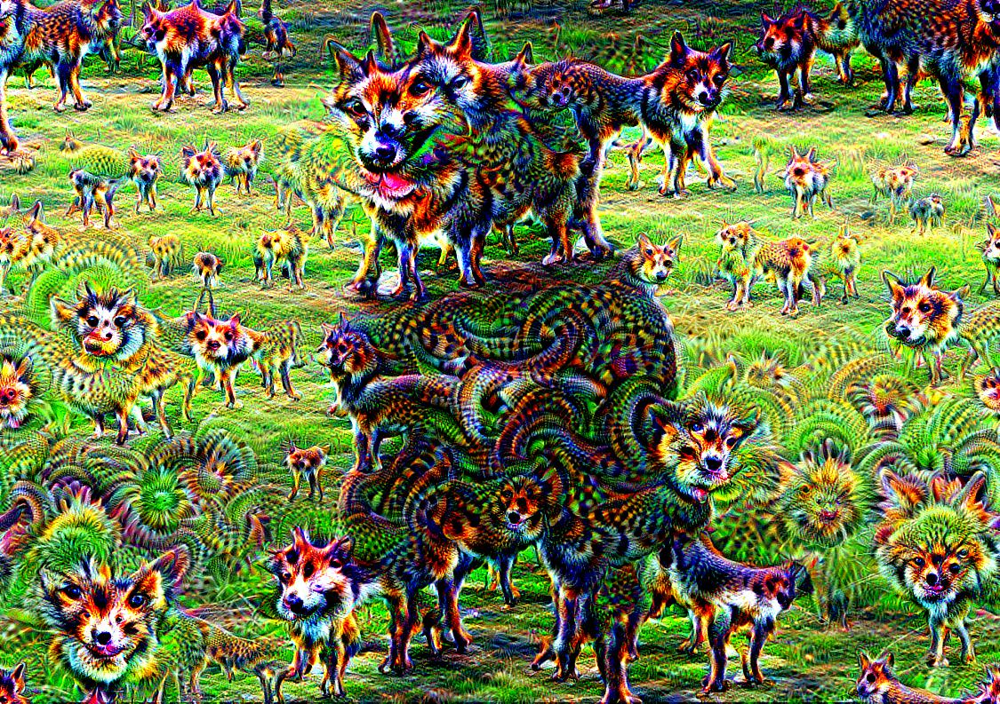

In [100]:
plotMixed(layers[idx[26]:idx[26]+1], img1)

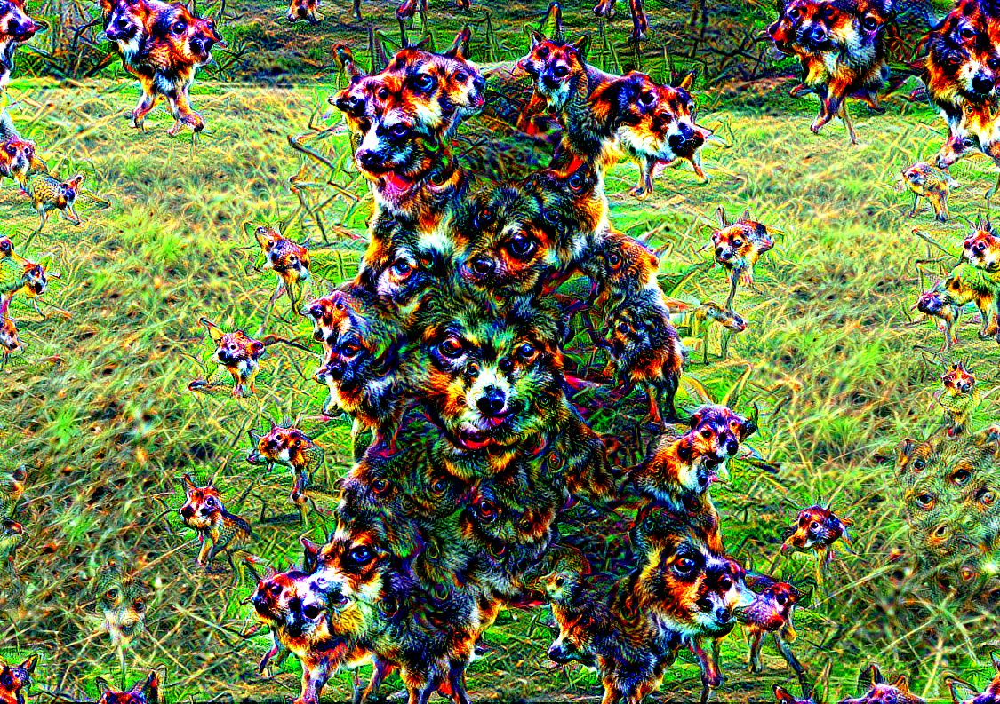

In [101]:
plotMixed(layers[idx[27]:idx[27]+1], img1)

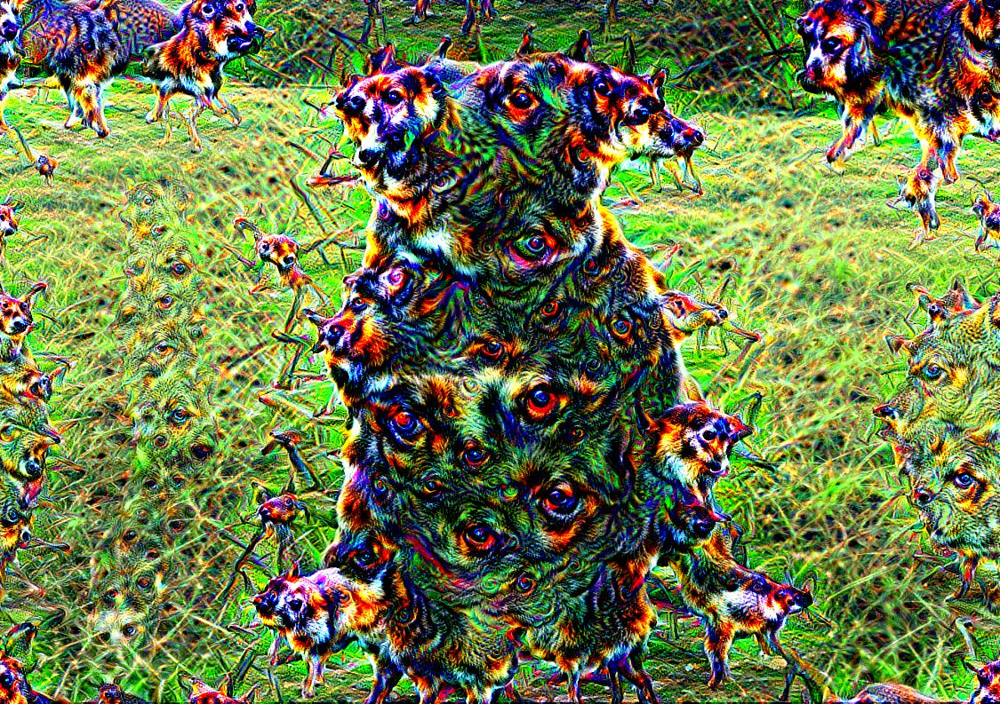

In [102]:
plotMixed(layers[idx[28]:idx[28]+1], img1)

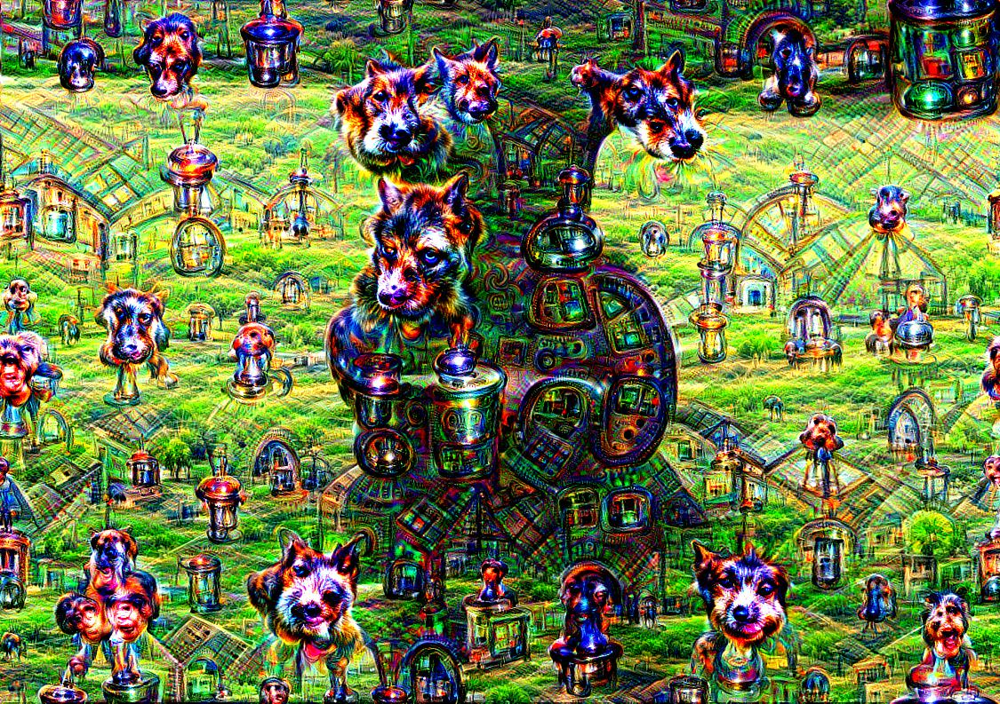

In [103]:
plotMixed(layers[idx[29]:idx[29]+1], img1)

#Figure 7.5
The previous 6 images belong to the 4c series.

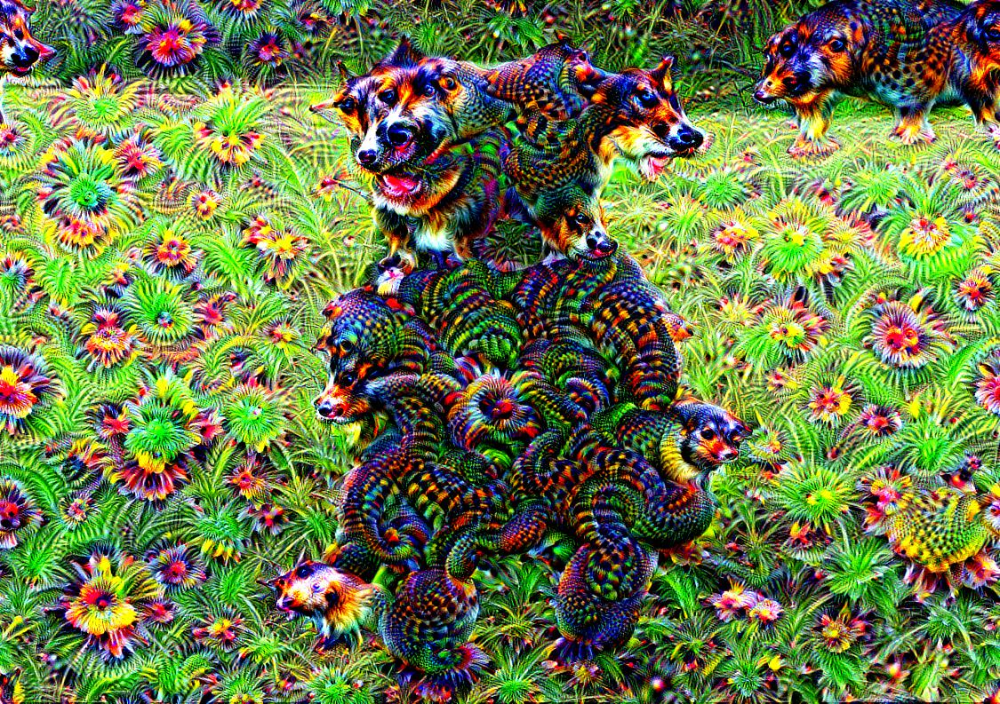

In [104]:
plotMixed(layers[idx[30]:idx[30]+1], img1)

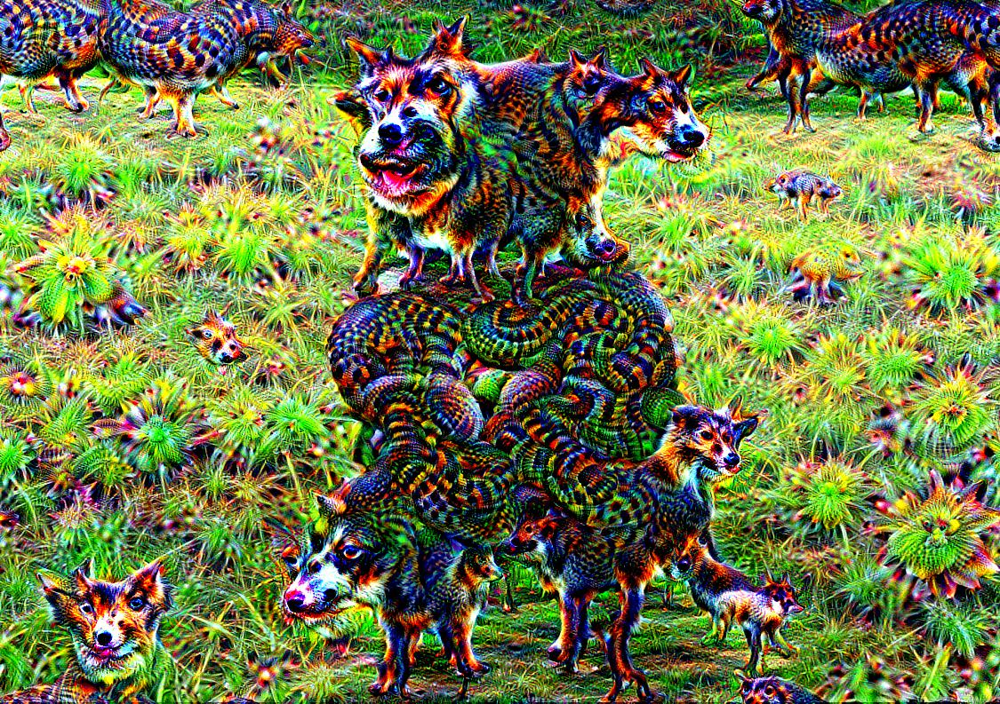

In [105]:
plotMixed(layers[idx[31]:idx[31]+1], img1)

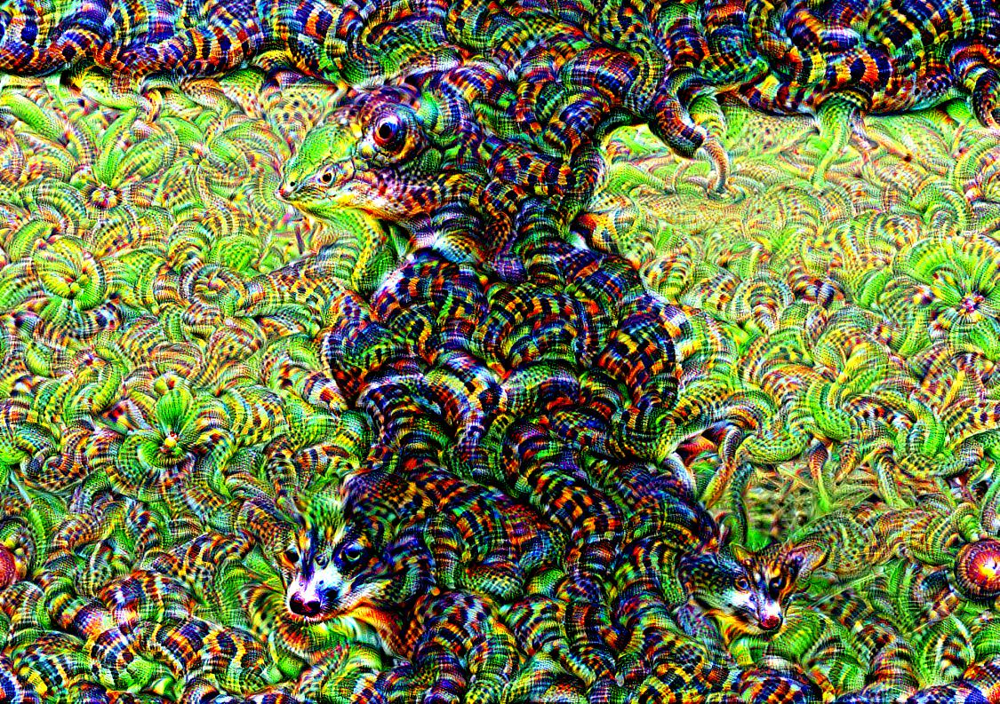

In [106]:
plotMixed(layers[idx[32]:idx[32]+1], img1)

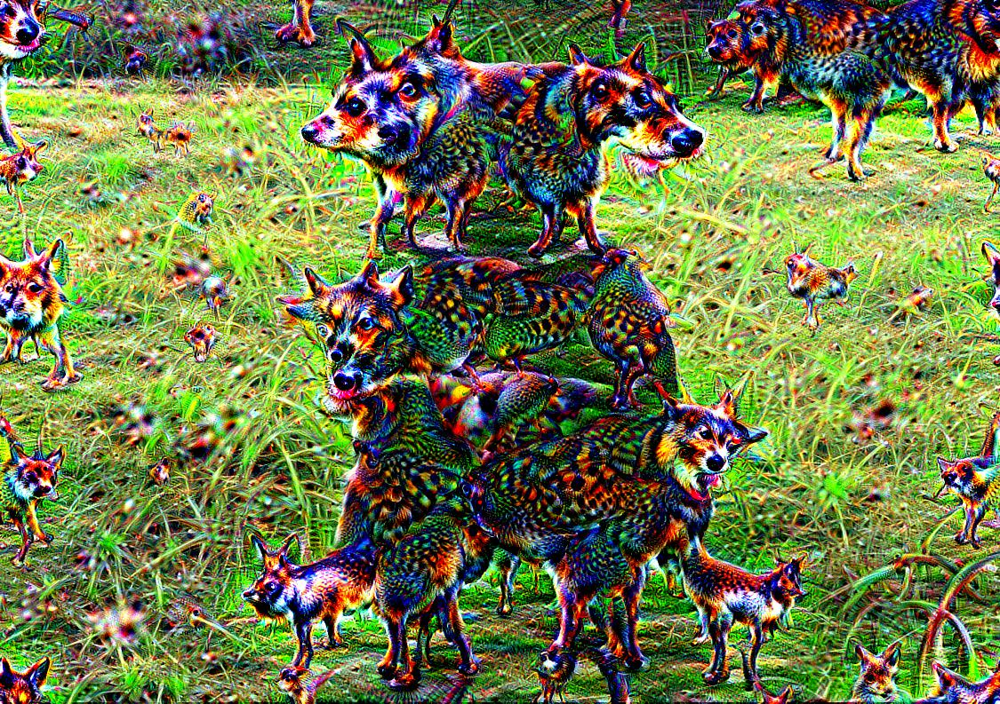

In [107]:
plotMixed(layers[idx[33]:idx[33]+1], img1)

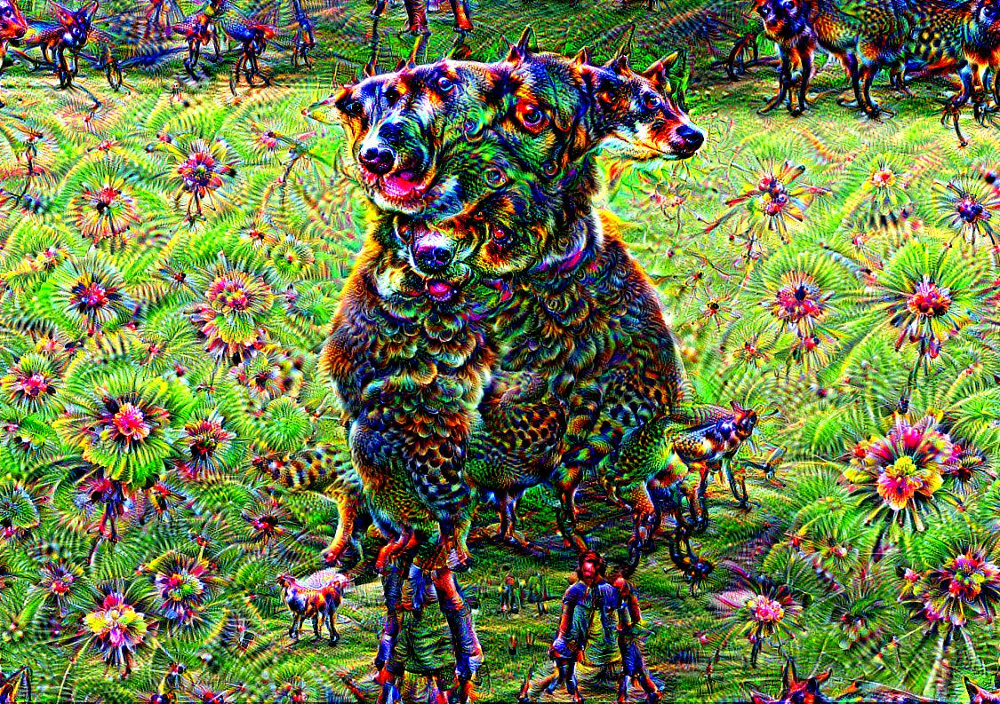

In [108]:
plotMixed(layers[idx[34]:idx[34]+1], img1)

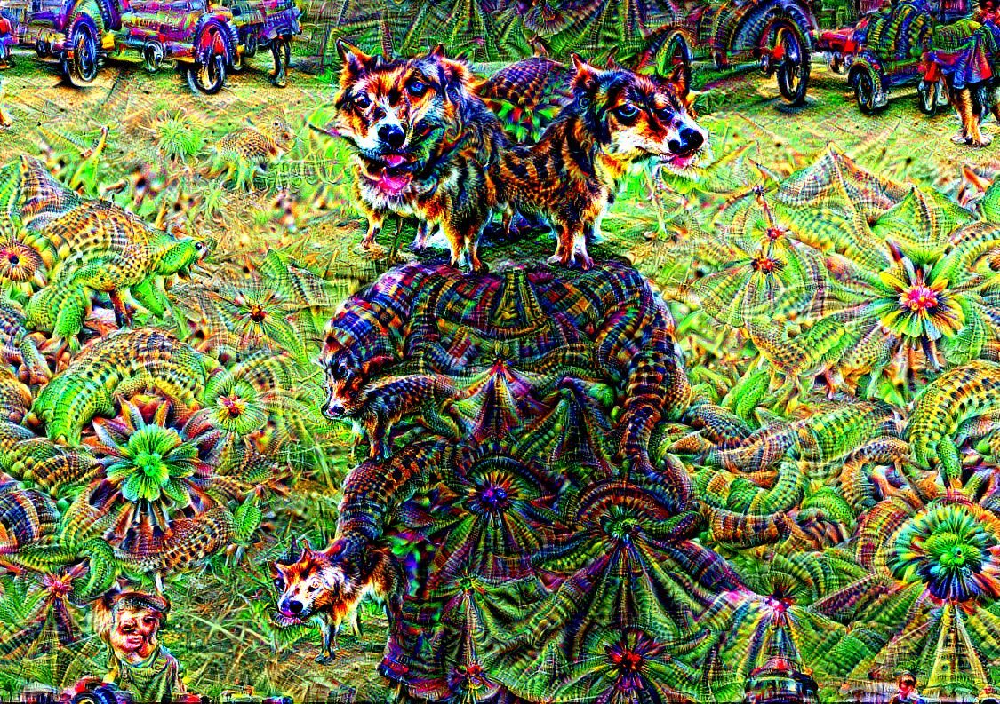

In [109]:
plotMixed(layers[idx[35]:idx[35]+1], img1)

#Figure 7.6
The previous 6 images belong to the 4d series.

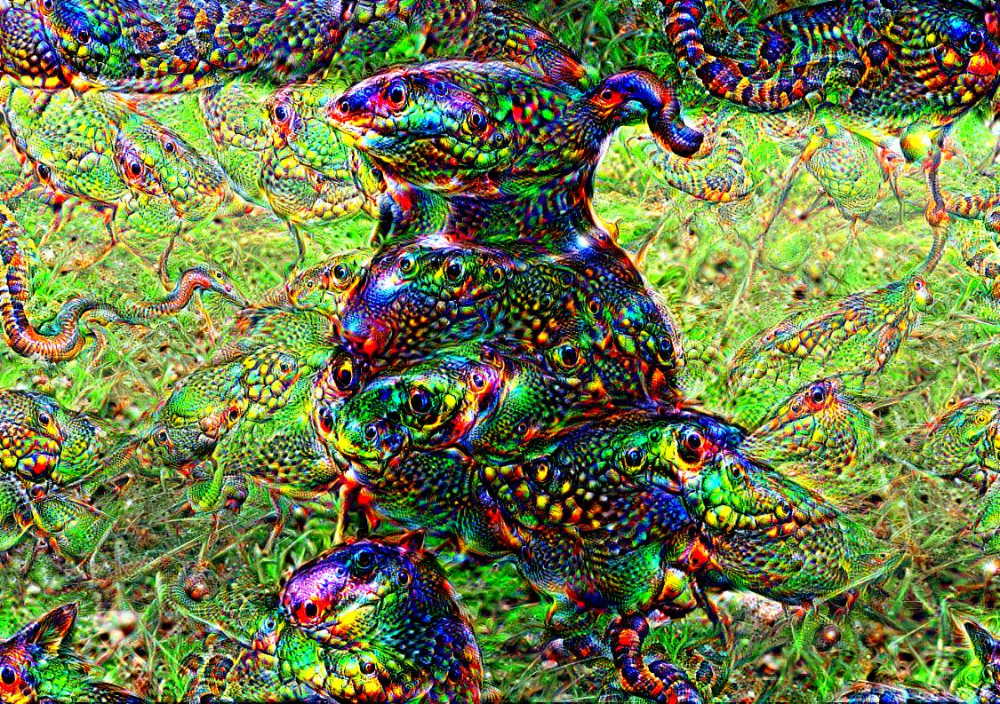

In [110]:
plotMixed(layers[idx[36]:idx[36]+1], img1)

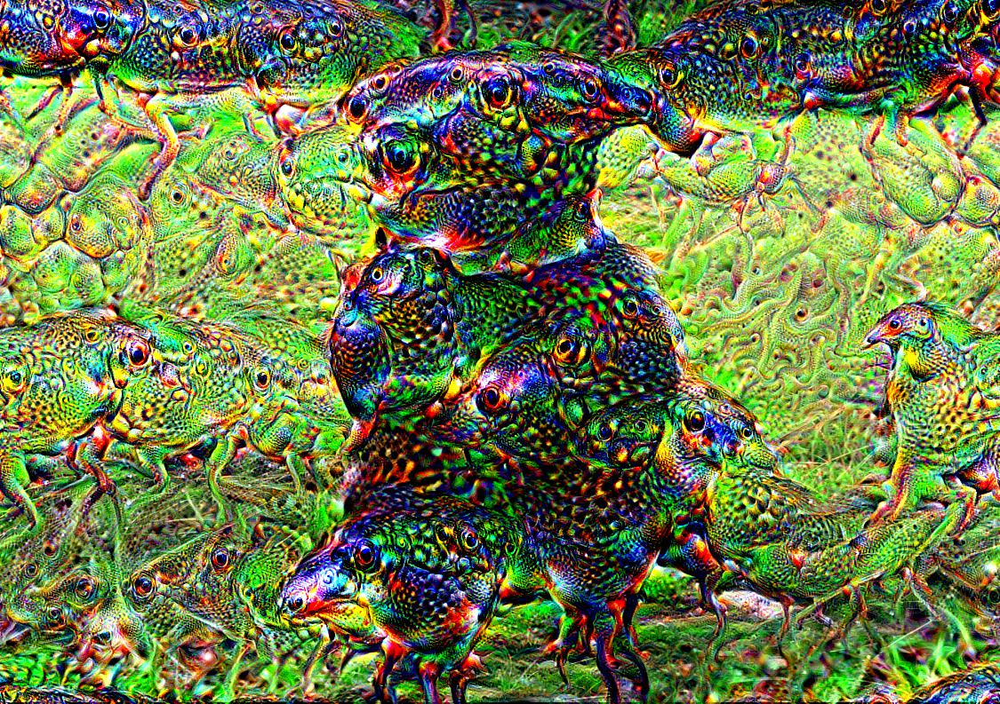

In [111]:
plotMixed(layers[idx[37]:idx[37]+1], img1)

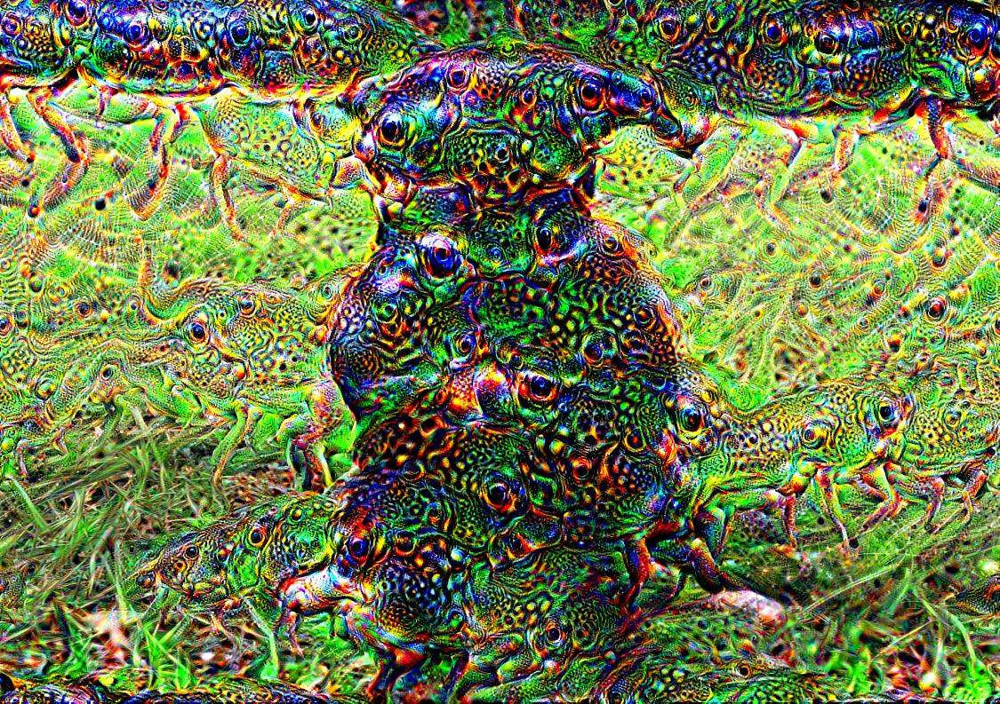

In [112]:
plotMixed(layers[idx[38]:idx[38]+1], img1)

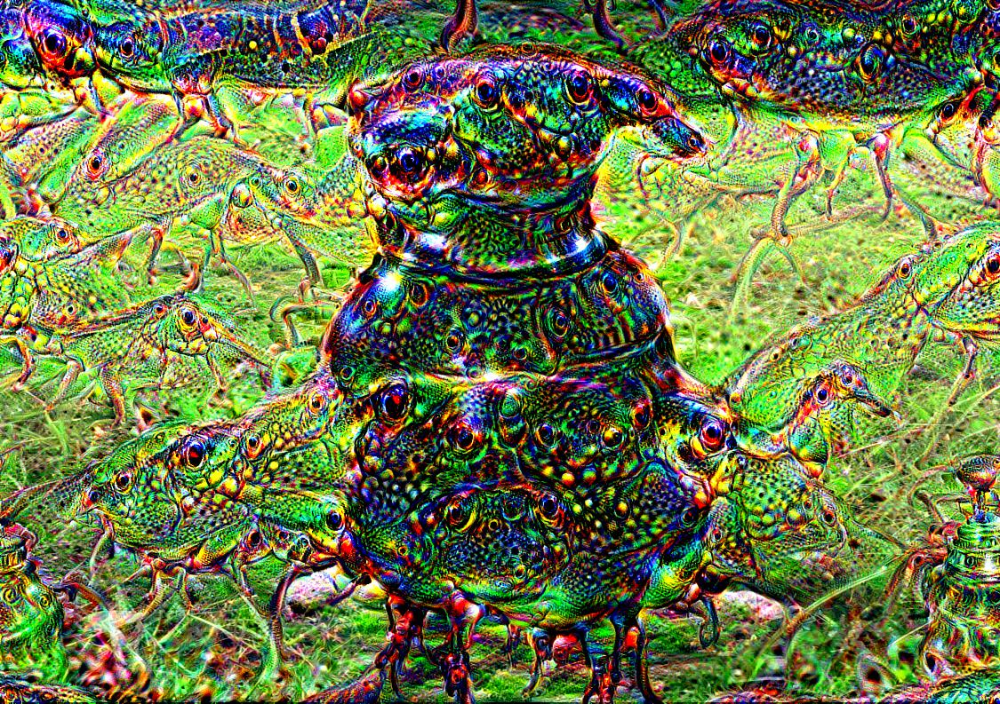

In [113]:
plotMixed(layers[idx[39]:idx[39]+1], img1)

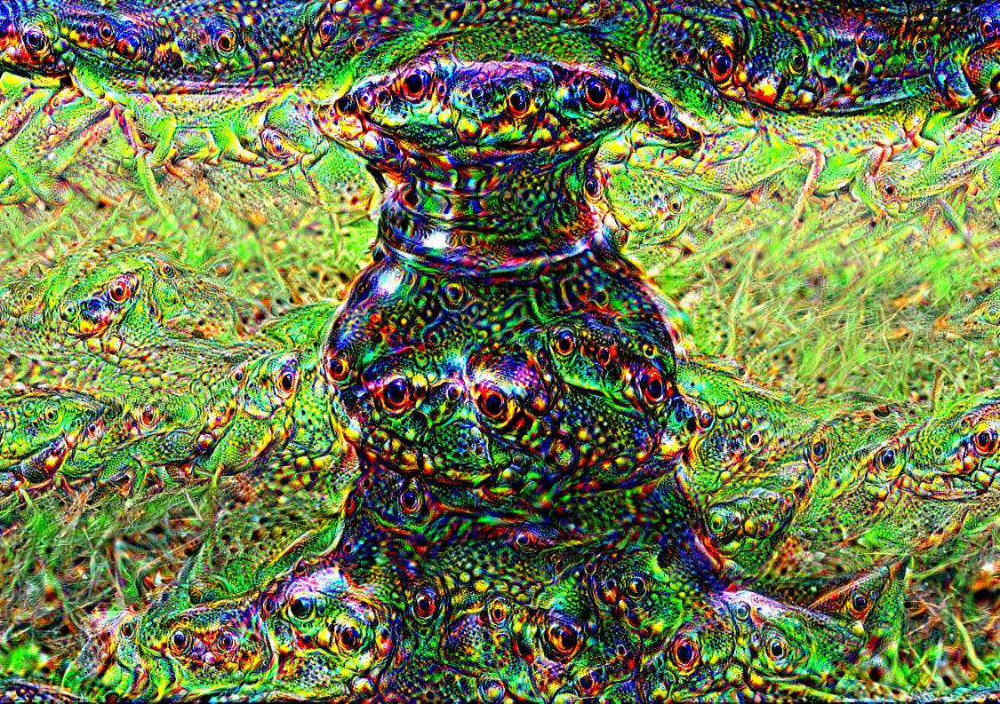

In [114]:
plotMixed(layers[idx[40]:idx[40]+1], img1)

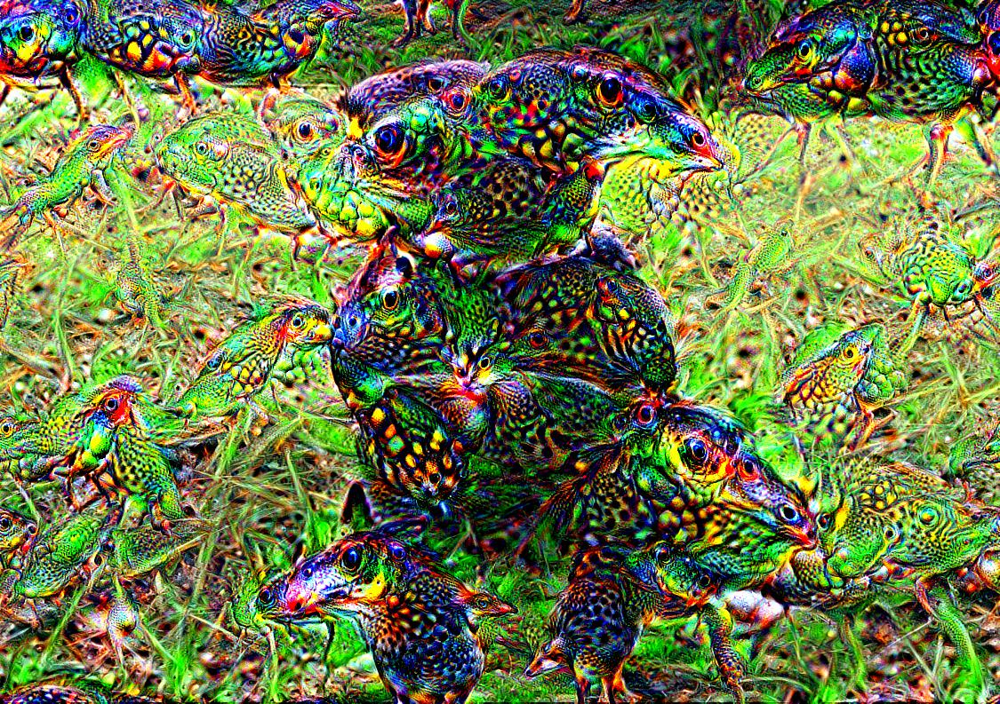

In [115]:
plotMixed(layers[idx[41]:idx[41]+1], img1)

#Figure 7.7
The previous 6 images belong to the 4e series.

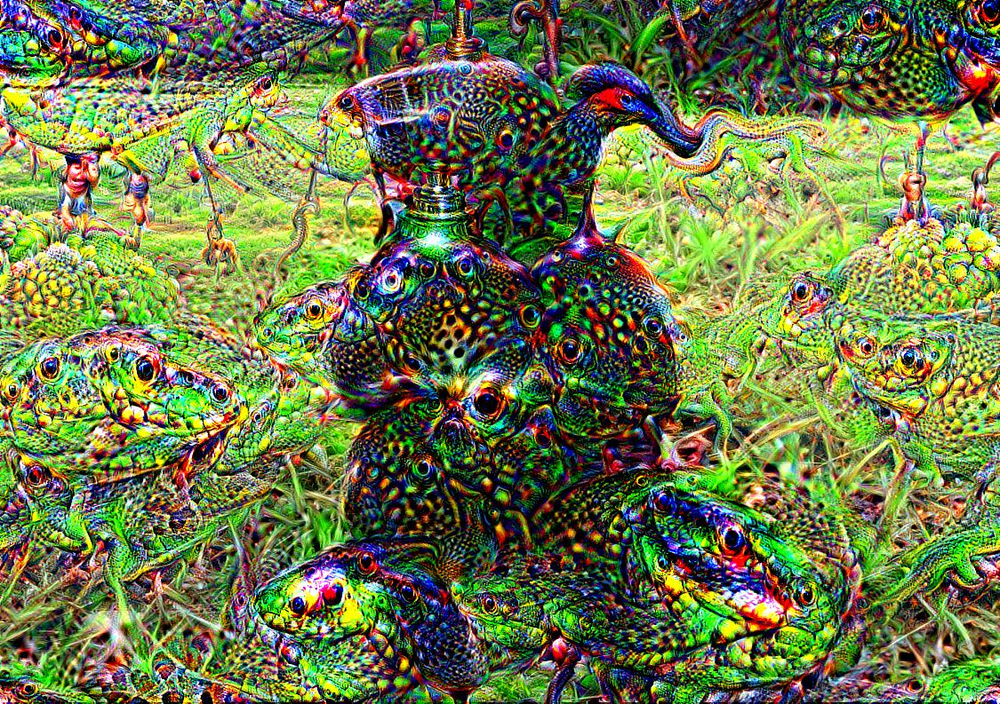

In [116]:
plotMixed(layers[idx[42]:idx[42]+1], img1)

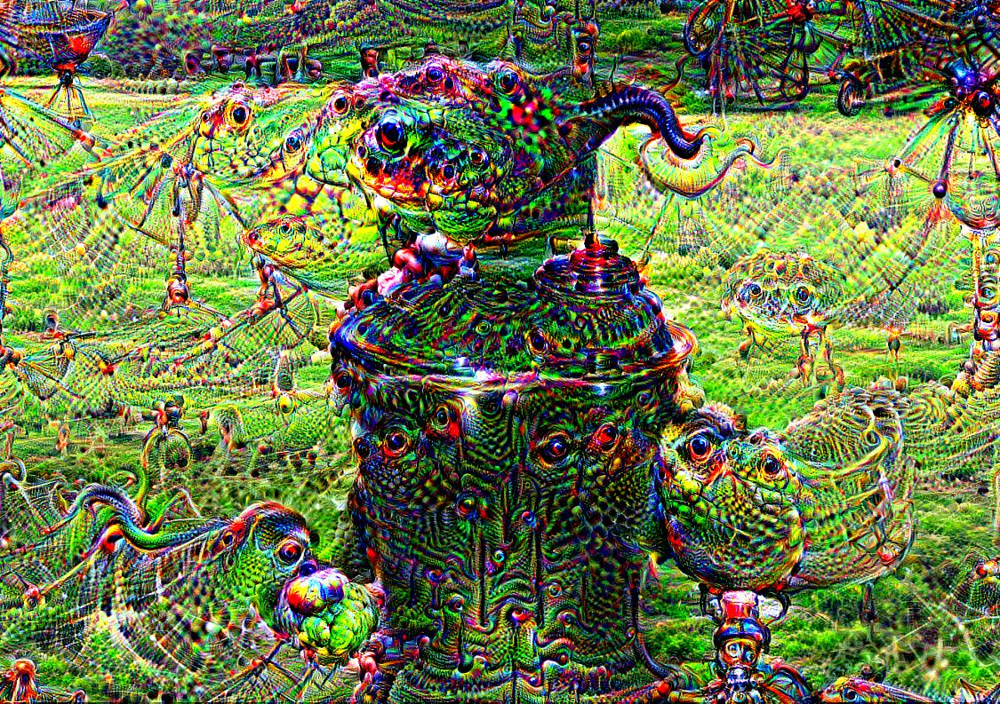

In [117]:
plotMixed(layers[idx[43]:idx[43]+1], img1)

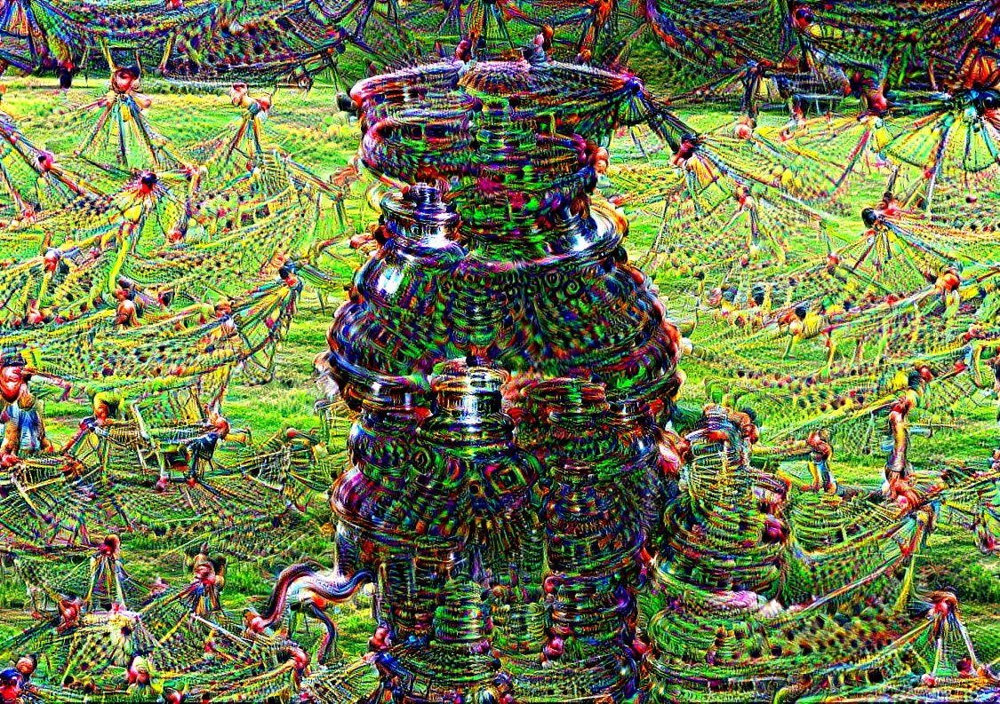

In [118]:
plotMixed(layers[idx[44]:idx[44]+1], img1)

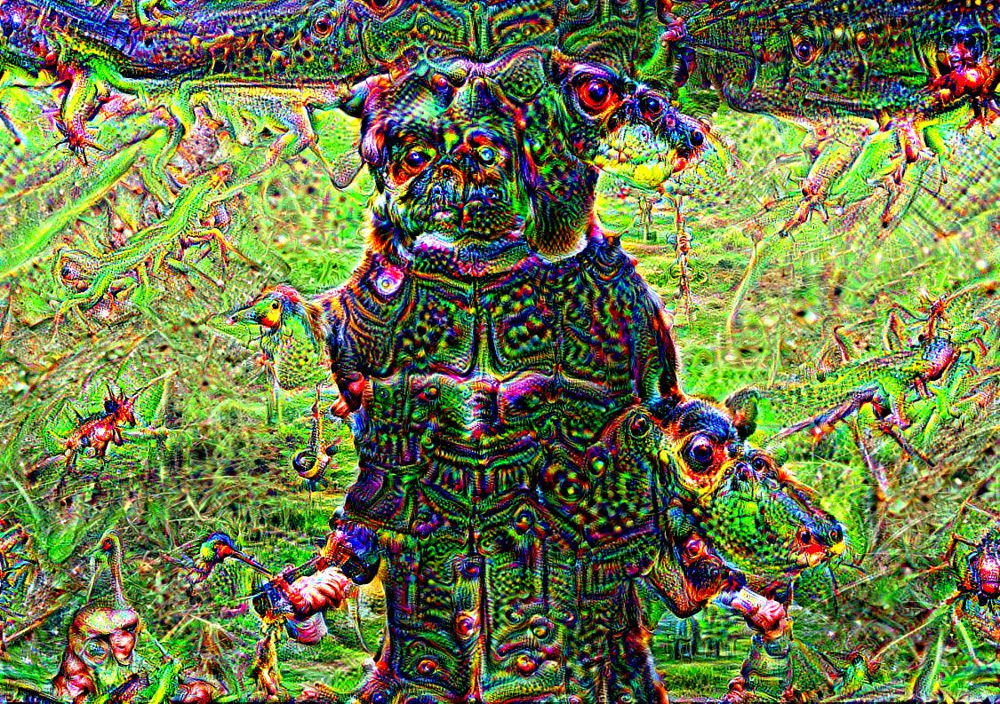

In [119]:
plotMixed(layers[idx[45]:idx[45]+1], img1)

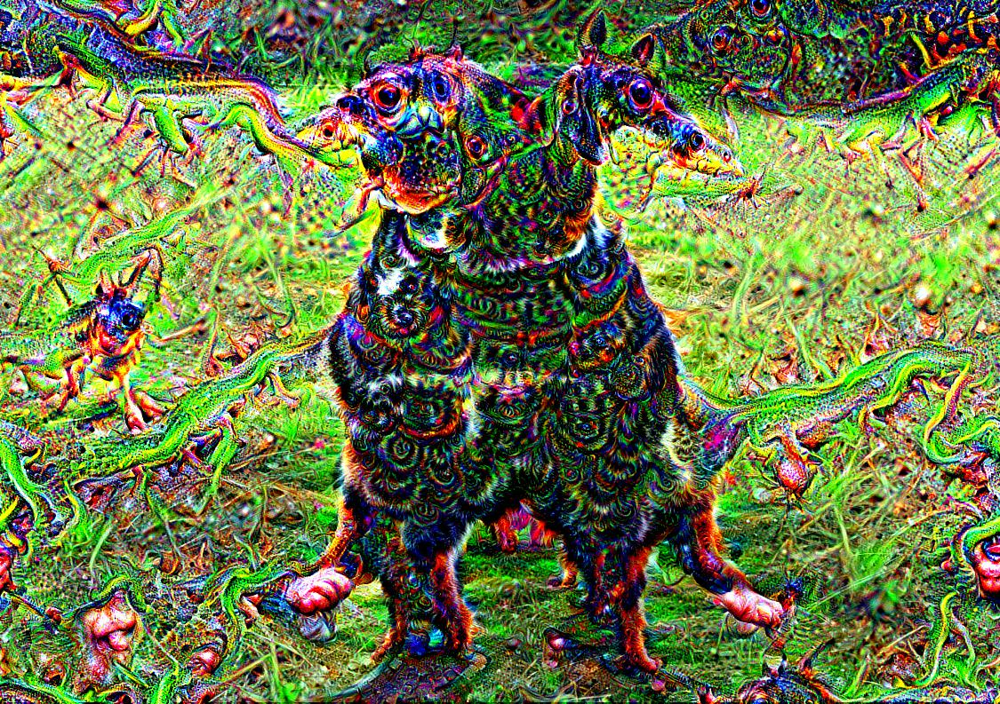

In [120]:
plotMixed(layers[idx[46]:idx[46]+1], img1)

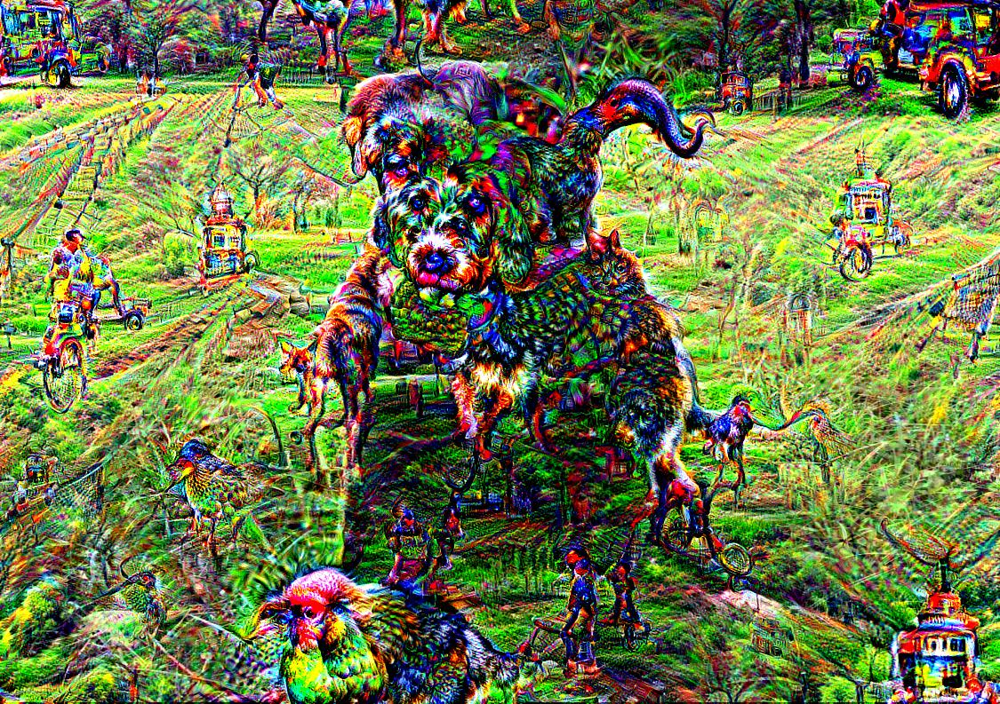

In [121]:
plotMixed(layers[idx[47]:idx[47]+1], img1)

#Figure 7.8
The previous 6 images belong to the 5a series.



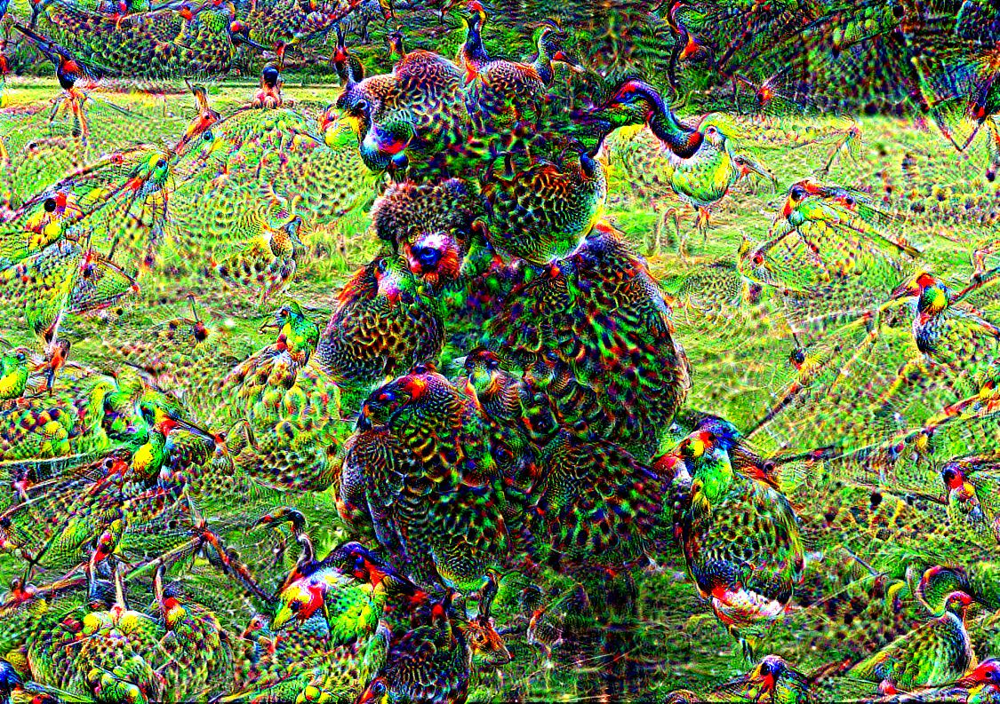

In [122]:
plotMixed(layers[idx[48]:idx[48]+1], img1)

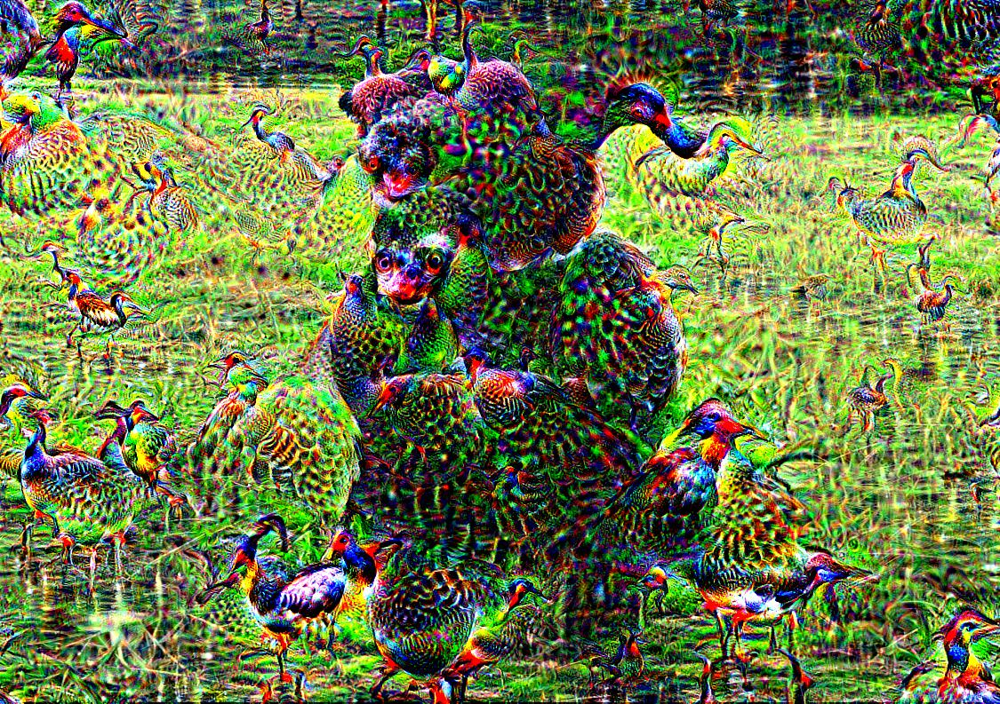

In [123]:
plotMixed(layers[idx[49]:idx[49]+1], img1)

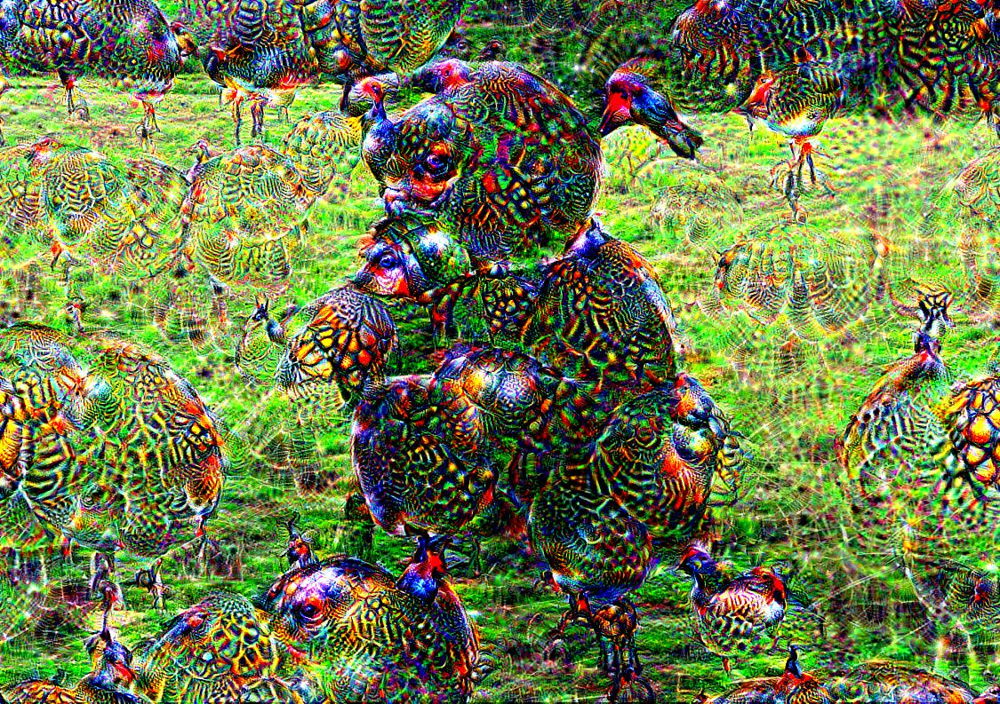

In [124]:
plotMixed(layers[idx[50]:idx[50]+1], img1)

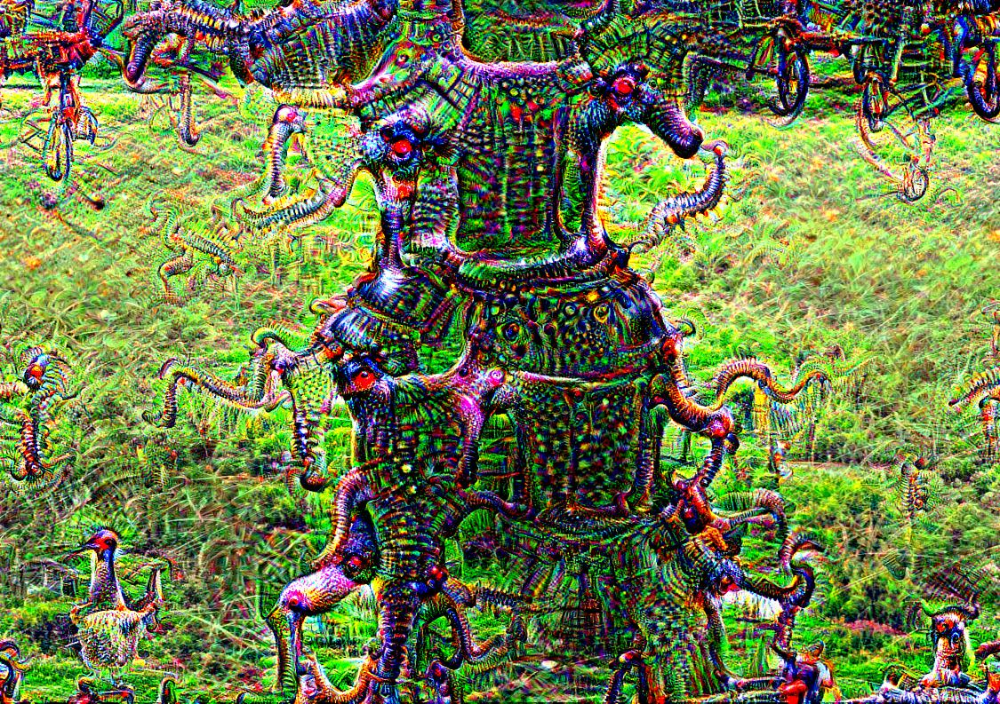

In [125]:
plotMixed(layers[idx[51]:idx[51]+1], img1)

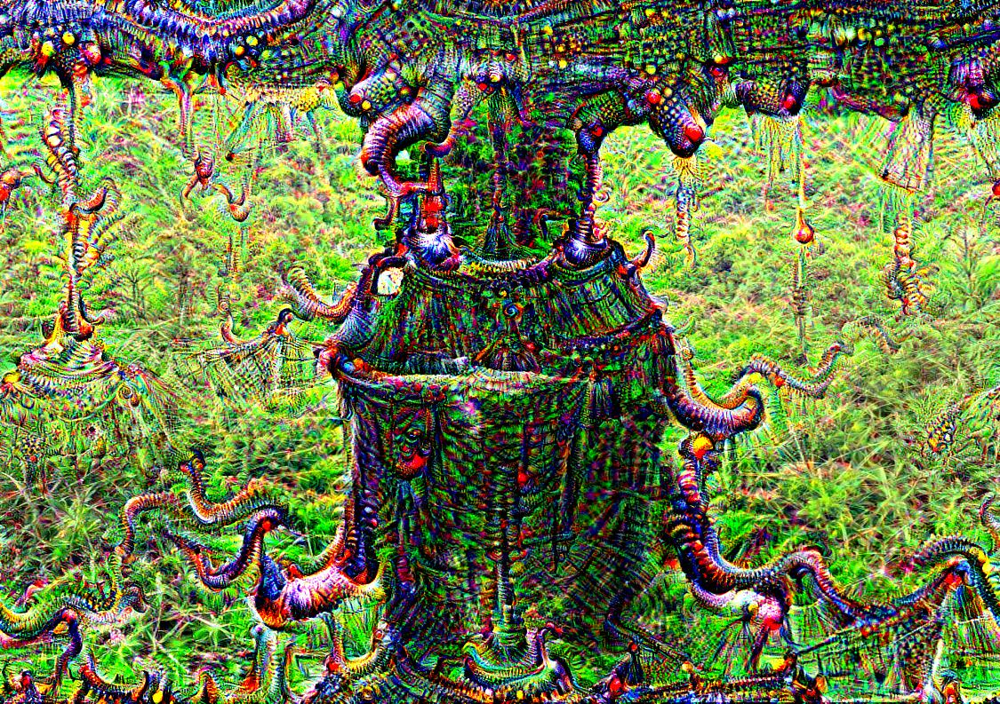

In [126]:
plotMixed(layers[idx[52]:idx[52]+1], img1)

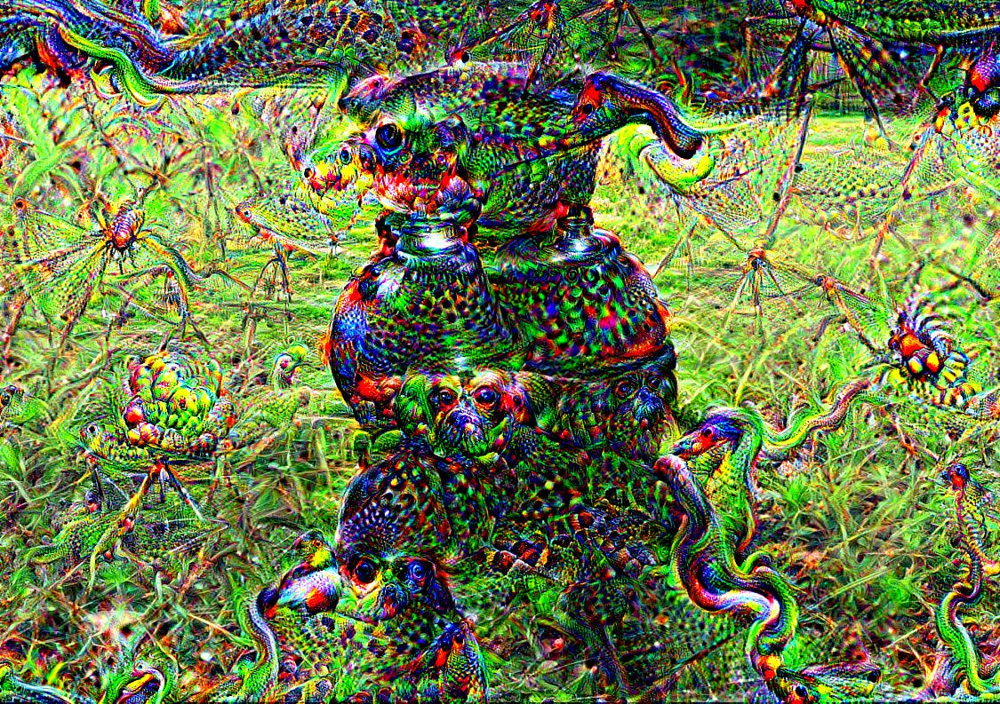

In [127]:
plotMixed(layers[idx[53]:idx[53]+1], img1)

#Figure 7.9
The previous 6 images belong to the 5b series.

# Task 8: Answer: Are there "animals" in your image? why? (there should be)


There are lots of animals in my image, as well as other inanimate objects. The neural network is trained on images of animals, and all animals have eyes. The model picks out eyes first, and then fills in animals around them.

### Further reading for the curious

 *   Original [DeepDream (Inceptionism) blog post](https://research.googleblog.com/2015/06/inceptionism-going-deeper-into-neural.html)
 *   [Original DeepDream algorithm](https://github.com/google/deepdream/blob/master/dream.ipynb) with Caffe

## Optional: Diving deeper into the Inception Model

Lets look a bit deeper into the Inception Model and visualize the layers. Each layer will produce a very different result when used in deep dreaming.

In [ ]:
layers = [op.name for op in graph.get_operations() if op.type=='Conv2D' and 'import/' in op.name]
feature_nums = [int(graph.get_tensor_by_name(name+':0').get_shape()[-1]) for name in layers]

print('Number of layers', len(layers))
print('Total number of feature channels:', sum(feature_nums))

for layer in layers:
  print('Layer:', layer)

Number of layers 59
Total number of feature channels: 7548
Layer: import/conv2d0_pre_relu/conv
Layer: import/conv2d1_pre_relu/conv
Layer: import/conv2d2_pre_relu/conv
Layer: import/mixed3a_1x1_pre_relu/conv
Layer: import/mixed3a_3x3_bottleneck_pre_relu/conv
Layer: import/mixed3a_3x3_pre_relu/conv
Layer: import/mixed3a_5x5_bottleneck_pre_relu/conv
Layer: import/mixed3a_5x5_pre_relu/conv
Layer: import/mixed3a_pool_reduce_pre_relu/conv
Layer: import/mixed3b_1x1_pre_relu/conv
Layer: import/mixed3b_3x3_bottleneck_pre_relu/conv
Layer: import/mixed3b_3x3_pre_relu/conv
Layer: import/mixed3b_5x5_bottleneck_pre_relu/conv
Layer: import/mixed3b_5x5_pre_relu/conv
Layer: import/mixed3b_pool_reduce_pre_relu/conv
Layer: import/mixed4a_1x1_pre_relu/conv
Layer: import/mixed4a_3x3_bottleneck_pre_relu/conv
Layer: import/mixed4a_3x3_pre_relu/conv
Layer: import/mixed4a_5x5_bottleneck_pre_relu/conv
Layer: import/mixed4a_5x5_pre_relu/conv
Layer: import/mixed4a_pool_reduce_pre_relu/conv
Layer: import/mixed4b_1

For example try deepdreaming with the layer '`mixed4a_3x3_pre_relu`'

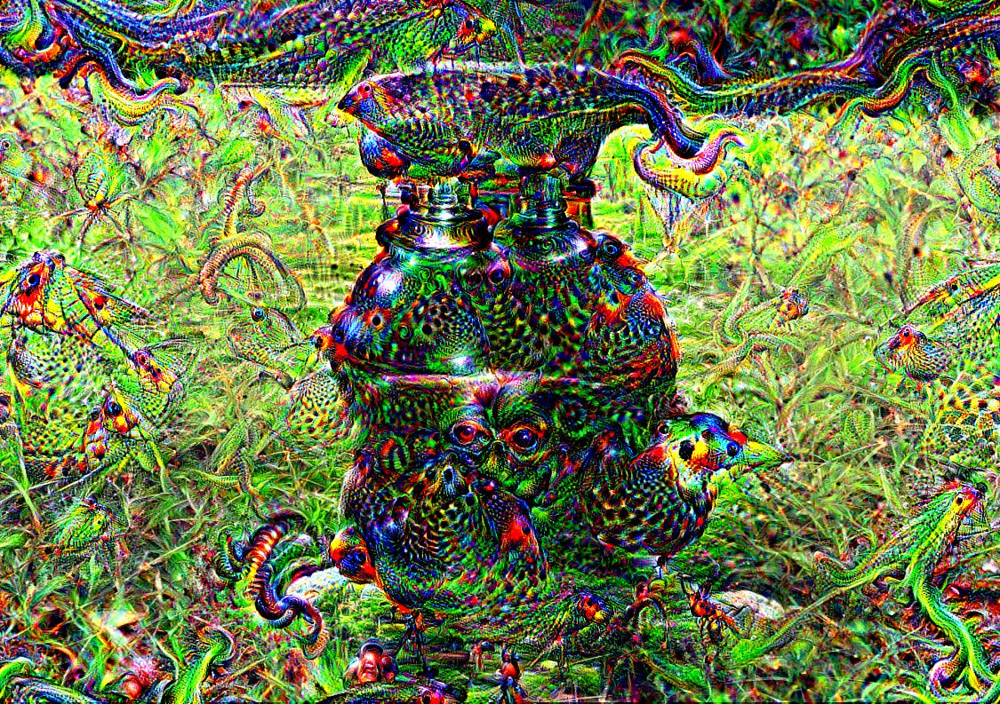

In [ ]:
layer = "mixed5b_pool_reduce_pre_relu"
final = render_deepdream(tf.square(T(layer)), img1)

We can also use TensorBoard to visualize the full graph to understand better how these different layers relate to each other. Most of the code in the next section just makes the graph look a little bit cleaner.

In [ ]:

# Helper functions for TF Graph visualization
from IPython.display import  HTML
def strip_consts(graph_def, max_const_size=32):
    """Strip large constant values from graph_def."""
    strip_def = tf.compat.v1.GraphDef()
    for n0 in graph_def.node:
        n = strip_def.node.add() 
        n.MergeFrom(n0)
        if n.op == 'Const':
            tensor = n.attr['value'].tensor
            size = len(tensor.tensor_content)
            if size > max_const_size:
                tensor.tensor_content = tf.compat.as_bytes("<stripped %d bytes>"%size)
    return strip_def
  
def rename_nodes(graph_def, rename_func):
    res_def = tf.compat.v1.GraphDef()
    for n0 in graph_def.node:
        n = res_def.node.add() 
        n.MergeFrom(n0)
        n.name = rename_func(n.name)
        for i, s in enumerate(n.input):
            n.input[i] = rename_func(s) if s[0]!='^' else '^'+rename_func(s[1:])
    return res_def
  
def show_graph(graph_def, max_const_size=32):
    """Visualize TensorFlow graph."""
    if hasattr(graph_def, 'as_graph_def'):
        graph_def = graph_def.as_graph_def()
    strip_def = strip_consts(graph_def, max_const_size=max_const_size)
    code = """
        <script>
          function load() {{
            document.getElementById("{id}").pbtxt = {data};
          }}
        </script>
        <link rel="import" href="https://tensorboard.appspot.com/tf-graph-basic.build.html" onload=load()>
        <div style="height:600px">
          <tf-graph-basic id="{id}"></tf-graph-basic>
        </div>
    """.format(data=repr(str(strip_def)), id='graph'+str(np.random.rand()))
  
    iframe = """
        <iframe seamless style="width:800px;height:620px;border:0" srcdoc="{}"></iframe>
    """.format(code.replace('"', '&quot;'))
    display(HTML(iframe))
tmp_def = rename_nodes(graph_def, lambda s:"/".join(s.split('_',1)))
tmp_def

In [ ]:

# Visualizing the network graph. Be sure expand the "mixed" nodes to see their 
# internal structure. We are going to visualize "Conv2D" nodes.
show_graph(graph_def)

In [ ]:
layer = "head0_bottleneck_pre_relu"
final = render_deepdream(tf.square(T(layer)), img1)

---

<h1 style="color:red"> Amazing !</h1>
